# W-net Unsupervised with Centroid loss 

## Download Data from Google Drive

In [2]:
from google.colab import files
from google.colab import auth
auth.authenticate_user()

In [3]:
def importFromDrive(filename, nameId):
  import io
  from googleapiclient.http import MediaIoBaseDownload, MediaFileUpload
  
  from googleapiclient.discovery import build
  drive_service = build('drive', 'v3')
  
  request = drive_service.files().get_media(fileId=nameId)
  variable = io.FileIO(filename, 'wb')
  downloader = MediaIoBaseDownload(variable, request)
  done = False
  while done is False:
    # _ is a placeholder for a progress object that we ignore.
    # (Our file is small, so we skip reporting progress.)
    _, done = downloader.next_chunk()

  variable.seek(0)

In [4]:
importFromDrive('trainSet.mat', '19vro2YKFiURqqmFGYYIx0ZDkirn4F9mk')
importFromDrive('testSet.mat', '1Gmb5aFWuR8kmfDjulgN2h90FutCxQVmF')
importFromDrive('original.zip', '16ibmmBvAYsw9ztlO6KpccQDAzvulEADX')
importFromDrive('segmented_onehot.zip', '16b1Xej2t3XqpyaaxJIa9VT0jsUurtXvY')
importFromDrive('classes.csv', '1V34MJgrbcRkoZBFdI-JuVtyAVAx39Oac')

In [4]:
!rm -r data/original data
!unzip original.zip -d data/
!unzip segmented_onehot.zip -d data/

rm: cannot remove 'data/original': No such file or directory
rm: cannot remove 'data': No such file or directory
Archive:  original.zip
   creating: data/original/
  inflating: data/original/20151127_114556.jpg  
  inflating: data/original/20151127_114946.jpg  
  inflating: data/original/20151127_115133.jpg  
  inflating: data/original/20151127_115151.jpg  
  inflating: data/original/20151127_115229.jpg  
  inflating: data/original/20151127_115424.jpg  
  inflating: data/original/20151127_115553.jpg  
  inflating: data/original/20151127_115951.jpg  
  inflating: data/original/20151127_120002.jpg  
  inflating: data/original/20151127_120128.jpg  
  inflating: data/original/20151127_120156.jpg  
  inflating: data/original/20151127_120208.jpg  
  inflating: data/original/20151127_120446.jpg  
  inflating: data/original/20151127_120643.jpg  
  inflating: data/original/20151127_120723.jpg  
  inflating: data/original/20151127_120755.jpg  
  inflating: data/original/20151127_120831.jpg  
  i


  inflating: data/original/20151127_131055.jpg  
  inflating: data/original/20151127_131106.jpg  
  inflating: data/original/20151127_131130.jpg  
  inflating: data/original/20151127_131150.jpg  
  inflating: data/original/20151127_131209.jpg  
  inflating: data/original/20151127_131259.jpg  
  inflating: data/original/20151127_131420.jpg  
  inflating: data/original/20151127_131439.jpg  
  inflating: data/original/20151127_131450.jpg  
  inflating: data/original/20151127_131553.jpg  
  inflating: data/original/20151127_131604.jpg  
  inflating: data/original/20151127_131713.jpg  
  inflating: data/original/20151127_131721.jpg  
  inflating: data/original/20151127_131751.jpg  
  inflating: data/original/20151127_131812.jpg  
  inflating: data/original/20151127_131828.jpg  
  inflating: data/original/20151127_131839.jpg  
  inflating: data/original/20151127_131852.jpg  
  inflating: data/original/20151127_131933.jpg  
  inflating: data/original/20151127_131948.jpg  
  inflating: data/o


  inflating: data/original/20151130_114525.jpg  
  inflating: data/original/20151130_114552.jpg  
  inflating: data/original/20151130_114603.jpg  
  inflating: data/original/20151130_114619.jpg  
  inflating: data/original/20151130_114633.jpg  
  inflating: data/original/20151130_114652.jpg  
  inflating: data/original/20151130_114710.jpg  
  inflating: data/original/20151130_114733.jpg  
  inflating: data/original/20151130_114818.jpg  
  inflating: data/original/20151130_114838.jpg  
  inflating: data/original/20151130_114910.jpg  
  inflating: data/original/20151130_114923.jpg  
  inflating: data/original/20151130_114930.jpg  
  inflating: data/original/20151130_114939.jpg  
  inflating: data/original/20151130_115044.jpg  
  inflating: data/original/20151130_115054.jpg  
  inflating: data/original/20151130_115115.jpg  
  inflating: data/original/20151130_115127.jpg  
  inflating: data/original/20151130_115202.jpg  
  inflating: data/original/20151130_115239.jpg  
  inflating: data/o


  inflating: data/original/20151203_122902.jpg  
  inflating: data/original/20151203_122910.jpg  
  inflating: data/original/20151203_122955.jpg  
  inflating: data/original/20151203_123019.jpg  
  inflating: data/original/20151203_123344.jpg  
  inflating: data/original/20151203_123432.jpg  
  inflating: data/original/20151203_124309.jpg  
  inflating: data/original/20151203_124353.jpg  
  inflating: data/original/20151203_124422.jpg  
  inflating: data/original/20151203_124440.jpg  
  inflating: data/original/20151203_124501.jpg  
  inflating: data/original/20151203_124558.jpg  
  inflating: data/original/20151203_124615.jpg  
  inflating: data/original/20151203_124649.jpg  
  inflating: data/original/20151203_124659.jpg  
  inflating: data/original/20151203_124739.jpg  
  inflating: data/original/20151203_124827.jpg  
  inflating: data/original/20151203_124903.jpg  
  inflating: data/original/20151203_124923.jpg  
  inflating: data/original/20151203_125059.jpg  
  inflating: data/o


  inflating: data/original/20151204_120423.jpg  
  inflating: data/original/20151204_120433.jpg  
  inflating: data/original/20151204_120442.jpg  
  inflating: data/original/20151204_120502.jpg  
  inflating: data/original/20151204_120525.jpg  
  inflating: data/original/20151204_120608.jpg  
  inflating: data/original/20151204_120630.jpg  
  inflating: data/original/20151204_120701.jpg  
  inflating: data/original/20151204_120743.jpg  
  inflating: data/original/20151204_120924.jpg  
  inflating: data/original/20151204_120942.jpg  
  inflating: data/original/20151204_121024.jpg  
  inflating: data/original/20151204_121047.jpg  
  inflating: data/original/20151204_121059.jpg  
  inflating: data/original/20151204_121118.jpg  
  inflating: data/original/20151204_121303.jpg  
  inflating: data/original/20151204_121329.jpg  
  inflating: data/original/20151204_121406.jpg  
  inflating: data/original/20151204_121427.jpg  
  inflating: data/original/20151204_121452.jpg  
  inflating: data/o


  inflating: data/original/20151204_130711.jpg  
  inflating: data/original/20151204_130733.jpg  
  inflating: data/original/20151204_130806.jpg  
  inflating: data/original/20151204_130950.jpg  
  inflating: data/original/20151204_131013.jpg  
  inflating: data/original/20151204_131048.jpg  
  inflating: data/original/20151204_131104.jpg  
  inflating: data/original/20151204_131144.jpg  
  inflating: data/original/20151204_131148.jpg  
  inflating: data/original/20151204_131212.jpg  
  inflating: data/original/20151204_131306.jpg  
  inflating: data/original/20151204_131326.jpg  
  inflating: data/original/20151204_131337.jpg  
  inflating: data/original/20151204_131412.jpg  
  inflating: data/original/20151204_131512.jpg  
  inflating: data/original/20151204_131528.jpg  
  inflating: data/original/20151204_131633.jpg  
  inflating: data/original/20151204_131644.jpg  
  inflating: data/original/20151204_131702.jpg  
  inflating: data/original/20151204_131728.jpg  
  inflating: data/o


  inflating: data/original/20151211_120256.jpg  
  inflating: data/original/20151211_120311.jpg  
  inflating: data/original/20151211_120328.jpg  
  inflating: data/original/20151211_120336.jpg  
  inflating: data/original/20151211_120352.jpg  
  inflating: data/original/20151211_120432.jpg  
  inflating: data/original/20151211_120606.jpg  
  inflating: data/original/20151211_120626.jpg  
  inflating: data/original/20151211_120710.jpg  
  inflating: data/original/20151211_120725.jpg  
  inflating: data/original/20151211_120752.jpg  
  inflating: data/original/20151211_120803.jpg  
  inflating: data/original/20151211_120836.jpg  
  inflating: data/original/20151211_120859.jpg  
  inflating: data/original/20151211_120915.jpg  
  inflating: data/original/20151211_120924.jpg  
  inflating: data/original/20151211_120936.jpg  
  inflating: data/original/20151211_121018.jpg  
  inflating: data/original/20151211_121043.jpg  
  inflating: data/original/20151211_121101.jpg  
  inflating: data/o


  inflating: data/original/20151211_130249.jpg  
  inflating: data/original/20151211_130330.jpg  
  inflating: data/original/20151211_130405.jpg  
  inflating: data/original/20151211_130428.jpg  
  inflating: data/original/20151211_130450.jpg  
  inflating: data/original/20151211_130638.jpg  
  inflating: data/original/20151211_130651.jpg  
  inflating: data/original/20151211_130709.jpg  
  inflating: data/original/20151211_130817.jpg  
  inflating: data/original/20151211_130826.jpg  
  inflating: data/original/20151211_130843.jpg  
  inflating: data/original/20151211_131011.jpg  
  inflating: data/original/20151211_131025.jpg  
  inflating: data/original/20151211_131044.jpg  
  inflating: data/original/20151211_131101.jpg  
  inflating: data/original/20151211_131130.jpg  
  inflating: data/original/20151211_131149.jpg  
  inflating: data/original/20151211_131312.jpg  
  inflating: data/original/20151211_131357.jpg  
  inflating: data/original/20151211_131643.jpg  
  inflating: data/o


  inflating: data/original/20151211_140744.jpg  
  inflating: data/original/20151211_140806.jpg  
  inflating: data/original/20151211_140855.jpg  
  inflating: data/original/20151211_141055.jpg  
  inflating: data/original/20151211_141158.jpg  
  inflating: data/original/20151211_141315.jpg  
  inflating: data/original/20151211_141344.jpg  
  inflating: data/original/20151211_141347.jpg  
  inflating: data/original/20151211_141357.jpg  
  inflating: data/original/20151211_141441.jpg  
  inflating: data/original/20151211_141559.jpg  
  inflating: data/original/20151211_141706.jpg  
  inflating: data/original/20151211_141807.jpg  
  inflating: data/original/20151211_141852.jpg  
  inflating: data/original/20151211_141909.jpg  
  inflating: data/original/20151211_141946.jpg  
  inflating: data/original/20151211_142212.jpg  
  inflating: data/original/20151211_142219.jpg  
  inflating: data/original/20151211_142240.jpg  
  inflating: data/original/20151211_142505.jpg  
  inflating: data/o


  inflating: data/original/20151221_122746.jpg  
  inflating: data/original/20151221_122804.jpg  
  inflating: data/original/20151221_122828.jpg  
  inflating: data/original/20151221_122924.jpg  
  inflating: data/original/20151221_123025.jpg  
  inflating: data/original/20151221_123043.jpg  
  inflating: data/original/20151221_123123.jpg  
  inflating: data/original/20151221_123135.jpg  
  inflating: data/original/20151221_123202.jpg  
  inflating: data/original/20151221_123252.jpg  
  inflating: data/original/20151221_123317.jpg  
  inflating: data/original/20151221_123341.jpg  
  inflating: data/original/20151221_123510.jpg  
  inflating: data/original/20151221_123544.jpg  
  inflating: data/original/20151221_123559.jpg  
  inflating: data/original/20151221_123614.jpg  
  inflating: data/original/20151221_123637.jpg  
  inflating: data/original/20151221_123701.jpg  
  inflating: data/original/20151221_123722.jpg  
  inflating: data/original/20151221_123824.jpg  
  inflating: data/o


  inflating: data/original/20151221_133513.jpg  
  inflating: data/original/20151221_133608.jpg  
  inflating: data/original/20151221_133613.jpg  
  inflating: data/original/20151221_133631.jpg  
  inflating: data/original/20151221_133737.jpg  
  inflating: data/original/20151221_133808.jpg  
  inflating: data/original/20151221_133902.jpg  
  inflating: data/original/20151221_133928.jpg  
  inflating: data/original/20151221_133957.jpg  
  inflating: data/original/20151221_134018.jpg  
  inflating: data/original/20151221_134043.jpg  
  inflating: data/original/20151221_134106.jpg  
  inflating: data/original/20151221_134140.jpg  
  inflating: data/original/20151221_134206.jpg  
  inflating: data/original/20151221_134224.jpg  
  inflating: data/original/20151221_134253.jpg  
  inflating: data/original/20151221_134329.jpg  
  inflating: data/original/20151221_134431.jpg  
  inflating: data/original/20151221_134533.jpg  
  inflating: data/original/20151221_134624.jpg  
  inflating: data/o


  inflating: data/segmented_onehot/20151127_131150/patate_pure.png  
   creating: data/segmented_onehot/20151127_131209/
  inflating: data/segmented_onehot/20151127_131209/pizzoccheri.png  
   creating: data/segmented_onehot/20151127_131259/
  inflating: data/segmented_onehot/20151127_131259/pizza.png  
   creating: data/segmented_onehot/20151127_131420/
  inflating: data/segmented_onehot/20151127_131420/arrosto.png  
  inflating: data/segmented_onehot/20151127_131420/mandarini.png  
  inflating: data/segmented_onehot/20151127_131420/patate_pure.png  
  inflating: data/segmented_onehot/20151127_131420/pizzoccheri.png  
   creating: data/segmented_onehot/20151127_131439/
  inflating: data/segmented_onehot/20151127_131439/carote.png  
  inflating: data/segmented_onehot/20151127_131439/torta_salata_spinaci_e_ricotta.png  
   creating: data/segmented_onehot/20151127_131450/
  inflating: data/segmented_onehot/20151127_131450/mandarini.png  
  inflating: data/segmented_onehot/20151127_13145


  inflating: data/segmented_onehot/20151130_121105/pane.png  
  inflating: data/segmented_onehot/20151130_121105/pasta_tonno_e_piselli.png  
  inflating: data/segmented_onehot/20151130_121105/patate_pure.png  
   creating: data/segmented_onehot/20151130_121124/
  inflating: data/segmented_onehot/20151130_121124/budino.png  
  inflating: data/segmented_onehot/20151130_121124/cotoletta.png  
  inflating: data/segmented_onehot/20151130_121124/patatine_fritte.png  
   creating: data/segmented_onehot/20151130_121144/
  inflating: data/segmented_onehot/20151130_121144/cotoletta.png  
  inflating: data/segmented_onehot/20151130_121144/patatine_fritte.png  
   creating: data/segmented_onehot/20151130_121212/
  inflating: data/segmented_onehot/20151130_121212/finocchi_in_umido.png  
  inflating: data/segmented_onehot/20151130_121212/mandarini.png  
  inflating: data/segmented_onehot/20151130_121212/merluzzo_alle_olive.png  
   creating: data/segmented_onehot/20151130_121224/
  inflating: data/

  inflating: data/segmented_onehot/20151204_113756/finocchi_gratinati.png  
  inflating: data/segmented_onehot/20151204_113756/pasta_pancetta_e_zucchine.png  
   creating: data/segmented_onehot/20151204_113839/
  inflating: data/segmented_onehot/20151204_113839/finocchi_gratinati.png  
  inflating: data/segmented_onehot/20151204_113839/lasagna_alla_bolognese.png  
  inflating: data/segmented_onehot/20151204_113839/pane.png  
  inflating: data/segmented_onehot/20151204_113839/pere.png  
   creating: data/segmented_onehot/20151204_113847/
  inflating: data/segmented_onehot/20151204_113847/cotoletta.png  
  inflating: data/segmented_onehot/20151204_113847/lasagna_alla_bolognese.png  
   creating: data/segmented_onehot/20151204_113948/
  inflating: data/segmented_onehot/20151204_113948/pasta_pancetta_e_zucchine.png  
  inflating: data/segmented_onehot/20151204_113948/yogurt.png  
   creating: data/segmented_onehot/20151204_114130/
  inflating: data/segmented_onehot/20151204_114130/riso_bia


  inflating: data/segmented_onehot/20151204_131212/pane.png  
  inflating: data/segmented_onehot/20151204_131212/pasta_pancetta_e_zucchine.png  
  inflating: data/segmented_onehot/20151204_131212/pere.png  
  inflating: data/segmented_onehot/20151204_131212/torta_salata_(alla_valdostana).png  
   creating: data/segmented_onehot/20151204_131306/
  inflating: data/segmented_onehot/20151204_131306/pasta_pancetta_e_zucchine.png  
   creating: data/segmented_onehot/20151204_131326/
  inflating: data/segmented_onehot/20151204_131326/arancia.png  
  inflating: data/segmented_onehot/20151204_131326/cotoletta.png  
  inflating: data/segmented_onehot/20151204_131326/finocchi_gratinati.png  
  inflating: data/segmented_onehot/20151204_131326/orecchiette_(ragu).png  
   creating: data/segmented_onehot/20151204_131337/
  inflating: data/segmented_onehot/20151204_131337/cotoletta.png  
  inflating: data/segmented_onehot/20151204_131337/finocchi_gratinati.png  
  inflating: data/segmented_onehot/201


  inflating: data/segmented_onehot/20151211_122045/patate_pure.png  
  inflating: data/segmented_onehot/20151211_122045/torta_salata_rustica_(zucchine).png  
   creating: data/segmented_onehot/20151211_122103/
  inflating: data/segmented_onehot/20151211_122103/budino.png  
  inflating: data/segmented_onehot/20151211_122103/cotoletta.png  
  inflating: data/segmented_onehot/20151211_122103/fagiolini.png  
  inflating: data/segmented_onehot/20151211_122103/patate_pure.png  
   creating: data/segmented_onehot/20151211_122133/
  inflating: data/segmented_onehot/20151211_122133/fagiolini.png  
  inflating: data/segmented_onehot/20151211_122133/pane.png  
  inflating: data/segmented_onehot/20151211_122133/pasta_e_fagioli.png  
  inflating: data/segmented_onehot/20151211_122133/spinaci.png  
   creating: data/segmented_onehot/20151211_122152/
  inflating: data/segmented_onehot/20151211_122152/fagiolini.png  
  inflating: data/segmented_onehot/20151211_122152/pane.png  
  inflating: data/segm

  inflating: data/segmented_onehot/20151211_141559/arrosto.png  
  inflating: data/segmented_onehot/20151211_141559/pane.png  
  inflating: data/segmented_onehot/20151211_141559/pasta_pesto_besciamella_e_cornetti.png  
   creating: data/segmented_onehot/20151211_141706/
  inflating: data/segmented_onehot/20151211_141706/arrosto.png  
  inflating: data/segmented_onehot/20151211_141706/zucchine_umido.png  
   creating: data/segmented_onehot/20151211_141807/
  inflating: data/segmented_onehot/20151211_141807/pane.png  
  inflating: data/segmented_onehot/20151211_141807/pasta_pesto_besciamella_e_cornetti.png  
   creating: data/segmented_onehot/20151211_141852/
  inflating: data/segmented_onehot/20151211_141852/fagiolini.png  
  inflating: data/segmented_onehot/20151211_141852/medaglioni_di_carne.png  
  inflating: data/segmented_onehot/20151211_141852/pane.png  
  inflating: data/segmented_onehot/20151211_141852/pasta_pesto_besciamella_e_cornetti.png  
   creating: data/segmented_onehot/2


  inflating: data/segmented_onehot/20151221_124934/pane.png  
  inflating: data/segmented_onehot/20151221_124934/pasta_sugo_vegetariano.png  
  inflating: data/segmented_onehot/20151221_124934/polpette_di_carne.png  
   creating: data/segmented_onehot/20151221_125054/
  inflating: data/segmented_onehot/20151221_125054/budino.png  
  inflating: data/segmented_onehot/20151221_125054/cavolfiore.png  
  inflating: data/segmented_onehot/20151221_125054/pane.png  
  inflating: data/segmented_onehot/20151221_125054/pasta_sugo_pesce.png  
  inflating: data/segmented_onehot/20151221_125054/polpette_di_carne.png  
   creating: data/segmented_onehot/20151221_125112/
  inflating: data/segmented_onehot/20151221_125112/pasta_sugo_pesce.png  
  inflating: data/segmented_onehot/20151221_125112/polpette_di_carne.png  
   creating: data/segmented_onehot/20151221_125211/
  inflating: data/segmented_onehot/20151221_125211/pane.png  
  inflating: data/segmented_onehot/20151221_125211/pasta_sugo_pesce.png 

## Libraries import 

In [6]:
import scipy.io
import keras
from keras import losses
from keras.layers.convolutional import Conv2D ,SeparableConv2D 
import os
import random
import sys
import warnings
import numpy as np
import pandas as pd
from itertools import chain
from skimage.io import imread, imshow, imread_collection, concatenate_images
from skimage.transform import resize
from skimage.morphology import label
from keras.utils import Progbar
from keras.models import Model, load_model
from keras.layers import Input
from keras.layers.core import Dropout, Lambda
from keras.layers.convolutional import Conv2D, Conv2DTranspose,Convolution2D
from keras.layers.pooling import MaxPooling2D
from keras.layers.merge import concatenate
from keras import backend as K
from keras.callbacks import ModelCheckpoint
import tensorflow as tf
import matplotlib.pyplot as plt
warnings.filterwarnings('ignore', category=UserWarning, module='skimage')
from skimage import data, segmentation, color
from skimage.future import graph
from matplotlib import pyplot as plt
import scipy.misc
from skimage import io; io.use_plugin('matplotlib')
from skimage.measure import label
import sklearn.preprocessing
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from keras.backend import int_shape
from keras import backend as K
from scipy import sparse
from skimage import img_as_bool
import cv2
import matplotlib.pyplot as plt
# Setting seed for reproducability
seed = 42
random.seed = seed
np.random.seed = seed

Using TensorFlow backend.


## Data preperation

In [8]:
train_ids = scipy.io.loadmat('trainSet.mat', squeeze_me=True)
test_ids = scipy.io.loadmat('testSet.mat', squeeze_me=True)
train_ids = train_ids['TrainingSet']
test_ids = test_ids['TestSet']

In [9]:
#gives 1 image in order to run the one image processing 
img = np.zeros((1,256,256,3))
i=5
im = imread('data/original/' + train_ids[i] + '.jpg')[:,:,:3]
im = resize(im, (256, 256), mode='constant')
img[0] = im

In [0]:
#creating a array with all the images for training
img = np.zeros((len(train_ids),256,256,3))
for i in range( len(train_ids)):
  im = imread('data/original/' + train_ids[i] + '.jpg')[:,:,:3]
  im = resize(im, (256, 256), mode='constant')
  img[i] = im

In [7]:
classes_ids = pd.read_csv('classes.csv', header=None)
classes_ids = classes_ids.values
classes_ids = classes_ids.squeeze()
total_classes = classes_ids.shape[0]
for i in range(0,classes_ids.shape[0]):
  classes_ids[i] = classes_ids[i].replace('/', '_')

## Loss Functions 

### Centroid loss

In [9]:
###################### centroid loss Function  ###########################

def features_similarity(u,v):
  c1,c2=u[:3],v[:3]
  iu,ju=u[3],u[4]
  iv,jv=v[3],v[4]
  
  dx=K.square(iu-iv)+K.square(ju-jv)
  dx=tf.to_float(dx)
  di=K.sum(K.square(c1-c2))
  di=tf.to_float(di)
  sigma_col=tf.to_float(5)#was 10
  sigma_pos=tf.to_float(20)#was 4
  d=di/sigma_col+dx/sigma_pos
  return K.exp(-(d))

def to_features(img):
  X_col=3*img
  X_pos=np.zeros((ROWS,COLS,2))
  for i in range(X_pos.shape[0]):
    X_pos[i,:,0]=float(i+1)/70#ROWS
    X_pos[:,i,1]=float(i+1)/70#COLS
  X_pos=tf.convert_to_tensor(X_pos,dtype='float32')
  
  X=tf.concat([X_col,X_pos],axis=2)
  X=K.reshape(X,(ROWS*COLS,5))
  return X


def features_similarity_matrix(X):
  print('building similarity matrix')
  W=tf.map_fn(elems=X,
              fn=lambda u: 
              tf.map_fn(elems=X,
                        fn=lambda v: 
                        features_similarity(u,v)),
              dtype='float32')
  return W

def mean(X):
  return K.mean(X,axis=0)
def cov(X,Y):
  return mean((X-mean(X))*(Y-mean(X)))
def var(X):
  return cov(X,X)

def wmean(X,w):
  w_sum=K.sum(w)
  return tf.cond(w_sum <= 0., lambda: tf.zeros_like(X[0]), lambda: K.sum(X*tf.expand_dims(w/w_sum, 1),axis=0) )
def wvar(X,w):
  return wmean(K.square(X-wmean(X,w)),w)

def class_ratio_penalty(r,n_classes):
  return tf.to_float(1.)+K.exp(-r*tf.to_float(n_classes)*tf.to_float(200))

def edges_length(P):
  #make the convolution ourselves
  kernel = np.array([[-1,-2,-1],[-2,12,-2],[-1,-2,-1]])
  convolution=K.zeros((ROWS-2,COLS-2,CLASSES))
  for i in range(3):
    ic=i-1#-1,0,1
    for j in range(3):
      jc=j-1#-1,0,1
      convolution+=kernel[i,j]*P[1+ic:ROWS-1+ic,1+jc:COLS-1+jc,:]
  convolution=K.square(convolution)#make it positive and more exagerated
  return K.sum(convolution)/K.sum(P)#sum in all axis

def centroids_similarity_loss(y_true,y_pred):
  img=y_true[0]
  P=y_pred[0]
  X=to_features(img)
  P=tf.reshape(y_pred[0],[ROWS*COLS,CLASSES])
    
  centroids    = tf.map_fn(elems=np.arange(CLASSES), fn=lambda k: wmean(X,P[:,k]),dtype='float32')#each element is a 5 coord vector RGBIJ
  variances    = tf.map_fn(elems=np.arange(CLASSES), fn=lambda k: wvar(X,P[:,k]), dtype='float32')#each element is a 5 coord vector RGBIJ
  class_ratios = tf.map_fn(elems=np.arange(CLASSES), fn=lambda k: mean(P[:,k]),   dtype='float32')#use this to prevent some classes to take over all pixels
  
  loss = tf.to_float(CLASSES, name='loss')
  for k1 in range(CLASSES):
    centroid1=centroids[k1]
    centroid_inter_similarity_mean=tf.to_float(0)
    for k2 in range(k1+1,CLASSES):
      centroid2=centroids[k2]
      centroid_inter_similarity_mean+=features_similarity(centroid1,centroid2)
    loss+=centroid_inter_similarity_mean*class_ratio_penalty(class_ratios[k1],CLASSES)
    centroid_intra_similarity = K.exp(-K.sum(variances[k1]))#variance is the mean squared distance to the centroid, and similarity is exp(-d**2)
    loss-=centroid_intra_similarity/(centroid_intra_similarity+centroid_inter_similarity_mean)#loss/(20*CLASSES*(CLASSES-1)/2)
  
  return (loss +edges_length(tf.reshape(P,(ROWS,COLS,CLASSES))))/(3*CLASSES*(CLASSES-1)/2)


def centroid_similarity_loss_no_variance(y_true,y_pred):
  img=y_true[0]
  P=y_pred[0]
  X=to_features(img)
  P=tf.reshape(y_pred[0],[ROWS*COLS,CLASSES])
  centroids = tf.matmul(tf.transpose(P),X)/tf.matmul(tf.transpose(P),tf.ones((ROWS*COLS,1)))

  loss = tf.to_float(0, name='loss')
  for k1 in range(CLASSES):
    centroid_inter_similarity_mean=tf.to_float(0)
    for k2 in range(k1+1,CLASSES):
      loss+=features_similarity(centroids[k1],centroids[k2])
  return (loss+edges_length(tf.reshape(P,(ROWS,COLS,CLASSES)))) /(CLASSES*(CLASSES-1)/2)

### Zero loss

In [10]:
def zero_loss(y_true, y_pred):
  loss = tf.to_float(0, name='loss')
  return loss

### Initialise the patameters of our loss function

In [11]:
ROWS = 256
COLS = 256
CLASSES = 8
CHANNELS = 3

## Data Visualization and Postprocessing  Functions 

### Postprocessing and Segmentation Visualization

In [12]:
def to_hard_segm_np(P):
  P_hard=np.zeros_like(P)
  for k in range(CLASSES):
    for i in range(ROWS):
      for j in range(COLS):
        P_hard[i,j,np.argmax(P[i,j])]=1
  return P_hard

def to_features_np(img):
  X_col=img
  X_pos=np.zeros((ROWS,COLS,2))
  for i in range(X_pos.shape[0]):
    X_pos[i,:,0]=float(i+1)/ROWS
    X_pos[:,i,1]=float(i+1)/COLS
  
  X=np.concatenate([X_col,X_pos],axis=2)
  X=np.reshape(X,(ROWS*COLS,5))
  return X

def paint_soft_centroid_color(img,P):
  P_vec=P.reshape((ROWS*COLS,P.shape[2]))
  X_np=to_features_np(img)
  centroids = P_vec.T.dot(X_np)/(P_vec.T.dot(np.ones((COLS*ROWS,1))))
  painted_img = np.array([centroids[np.argmax(P_vec[i])][:3] for i in range(ROWS*COLS)]).reshape(ROWS,COLS,CHANNELS)
  return painted_img

def paint_hard_centroid_color(img,P):
  P_hard=to_hard_segm_np(np.reshape(P,(ROWS,COLS,CLASSES)))
  return paint_soft_centroid_color(img,P_hard)

def plot_probabilities(img,P):
  P_vec=P.reshape((ROWS*COLS,CLASSES))
  X_np=to_features_np(img)
  centroids = P_vec.T.dot(X_np)/(P_vec.T.dot(np.ones((COLS*ROWS,1))))
  
  height=20
  plt.figure(figsize=(height,CLASSES*height))
  for k in range(CLASSES):
    plt.subplot(1,CLASSES,k+1)
    class_k_img=np.array([P_vec[i,k] for i in range(ROWS*COLS)]).reshape(ROWS,COLS)
    plt.imshow(class_k_img)
    plt.title('class '+str(k+1)+' probability'),plt.xticks([]), plt.yticks([])
  plt.show()

def plot_winners(img,P):
  P_vec=P.reshape((ROWS*COLS,CLASSES))
  X_np=to_features_np(img)
  centroids = P_vec.T.dot(X_np)/(P_vec.T.dot(np.ones((COLS*ROWS,1))))
  height=20
  plt.figure(figsize=(height,CLASSES*height))
  for k in range(CLASSES):
    plt.subplot(1,CLASSES,k+1)
    class_k_img=np.array([(np.argmax(P_vec[i])==k) for i in range(ROWS*COLS)]).reshape(ROWS,COLS)
    
    plt.imshow(class_k_img)
    plt.title('class '+str(k+1)+' winners'),plt.xticks([]), plt.yticks([])
  plt.show()

'''Post-processing Function'''
def connectivity_split(img,P):
  '''Split each class into as many connected components it has'''
  P_vec=P.reshape((ROWS*COLS,CLASSES))
  P_new_classes=[]
  for k in range(CLASSES):
    #get the pixels where class k has higher probability than the rest of classes
    class_k_img=np.array([(np.argmax(P_vec[i])==k) for i in range(ROWS*COLS)]).reshape(ROWS,COLS)    
    #assign a label to each connected component
    label_array=label(class_k_img,background=0)
    
    #one hot
    label_list = label_array.reshape(ROWS*COLS)
    n_labels=max(label_list)+1
    label_binarizer = sklearn.preprocessing.LabelBinarizer()
    label_binarizer.fit(range(n_labels))
    one_hot = label_binarizer.transform(label_list)
    if n_labels==2:
      one_hot = np.hstack((one_hot, 1 - one_hot))
    one_hot=one_hot.reshape(ROWS,COLS,n_labels)
    one_hot=one_hot[:,:,1:]#delete background class
    P_new_classes.append(one_hot)
  P_new_classes=np.concatenate(P_new_classes,axis=-1)
  
  return paint_soft_centroid_color(img,P_new_classes)

def paints(img,P,rec):  
  plt.figure(figsize=(20,60))
  plt.subplot(1,4,1)
  plt.imshow(img)
  plt.title('original image'),plt.xticks([]), plt.yticks([])

  plt.subplot(1,4,2)
  painted_img = paint_hard_centroid_color(img,P)
  plt.imshow(painted_img)
  plt.title('hard centroid color'),plt.xticks([]), plt.yticks([])
  
  painted_img = connectivity_split(img,P)
  if painted_img is not None:
    plt.subplot(1,4,3)
    plt.imshow(painted_img)
    plt.title('postprocessed'),plt.xticks([]), plt.yticks([])
    
  plt.subplot(1,4,4)
  plt.imshow(rec)
  plt.title('reconstruction'),plt.xticks([]), plt.yticks([])

  plot_probabilities(img,P)
  plot_winners(img,P)
  plt.show()
  
  
'''3D paint '''  
def paint_hard_centroid_color_img(img,P):
  P_hard=to_hard_segm_np(np.reshape(P,(ROWS,COLS,CLASSES)))
  P_vec=P_hard.reshape((ROWS*COLS,CLASSES))
  X_np=to_features_np(img)
  centroids = P_vec.T.dot(X_np)/(P_vec.T.dot(np.ones((COLS*ROWS,1))))
  painted_img = np.array([centroids[np.argmax(P_vec[i])][:3] for i in range(ROWS*COLS)]).reshape(ROWS,COLS,CHANNELS)
  return painted_img


def hard_centroid_pixel_scatter3D(img,P):
  P_hard=to_hard_segm_np(np.reshape(P,(ROWS,COLS,CLASSES)))
  P_vec=P_hard.reshape((ROWS*COLS,CLASSES))
  X_np=to_features_np(img)
  centroids = P_vec.T.dot(X_np)/(P_vec.T.dot(np.ones((COLS*ROWS,1))))
  painted_img = np.array([centroids[np.argmax(P_vec[i])][:3] for i in range(ROWS*COLS)]).reshape(ROWS,COLS,CHANNELS)
  colour1 = img.reshape((ROWS*COLS,CHANNELS))
  colour2 = paint_hard_centroid_color_img(img, P).reshape((ROWS*COLS,CHANNELS))
  x = list(img[:,:,0].reshape((ROWS*COLS)))
  y = list(img[:,:,1].reshape((ROWS*COLS)))
  z = list(img[:,:,2].reshape((ROWS*COLS)))
  fig = plt.figure(figsize=(30,15))
  plt.title('original colours'),plt.xticks([]), plt.yticks([])
  ax1 = fig.add_subplot(121, projection='3d')
  ax1.scatter3D(x, y, z,c=colour1)
  plt.title('original hard'),plt.xticks([]), plt.yticks([])
  ax2 = fig.add_subplot(122, projection='3d')
  ax2.scatter3D(x, y, z,c=colour2)
  plt.show()

### IOU

In [13]:
def IOU(truth, segm):
  if truth.shape != segm.shape:
    print("Groud truth and segmented image should have the same size.")
    return
  truth = truth/np.max(truth)
  segm = segm/np.max(segm)
  intersection = np.logical_and(truth, segm)
  inter_count = np.sum(intersection)
  union = np.logical_or(truth, segm)
  union_count = np.sum(union)
  iou = inter_count/union_count
  return iou
  
def mean_IOU(truth, segm):
  if truth.shape != segm.shape:
    print("Groud truth and segmented images should have the same size.")
    return
  nb_img = truth.shape[0]
  sum_iou = 0
  for i in range(nb_img):
    sum_iou = sum_iou + IOU(truth[i], segm[i])
  mean_iou = sum_iou/nb_img
  return mean_iou

def get_connectivity_split(img,P):
  '''Split each class into as many connected components it has'''
  P_vec=P.reshape((ROWS*COLS,CLASSES))
  P_new_classes=[]
  for k in range(CLASSES):
    #get the pixels where class k has higher probability than the rest of classes
    class_k_img=np.array([(np.argmax(P_vec[i])==k) for i in range(ROWS*COLS)]).reshape(ROWS,COLS)    
    #assign a label to each connected component
    label_array=label(class_k_img,background=0)
    
    #one hot
    label_list = label_array.reshape(ROWS*COLS)
    n_labels=max(label_list)+1
    label_binarizer = sklearn.preprocessing.LabelBinarizer()
    label_binarizer.fit(range(n_labels))
    one_hot = label_binarizer.transform(label_list)
    if n_labels==2:
      one_hot = np.hstack((one_hot, 1 - one_hot))
    one_hot=one_hot.reshape(ROWS,COLS,n_labels)
    one_hot=one_hot[:,:,1:]#delete background class
    P_new_classes.append(one_hot)
  P_new_classes=np.concatenate(P_new_classes,axis=-1)
  return P_new_classes

def get_best_component_iou(img, truth, P):
  best = 0
  for k in range(P.shape[2]):
    iou = IOU(truth, P[:,:,k])
    if(iou > best):
      best = iou
  return best

def get_best_component(img, truth, P):
  best = 0
  segm = P[:,:,0]
  for k in range(P.shape[2]):
    iou = IOU(truth, P[:,:,k])
    if(iou > best):
      best = iou
      segm = P[:,:,k]
  return segm

def segmentation_IOU(img, segm, i):
  n = 256
  m = 256
  original_mask = 'data/segmented_onehot/'
  mean_IOU = 0
  img_id = test_ids[i]
  count = 0
  sum_IOU = 0
  for j in range(len(classes_ids)):
    fname = original_mask + img_id + '/' + classes_ids[j] + '.png'
    if os.path.isfile(fname):
      truth = imread(fname, flatten=True)
      truth = resize(truth, (256,256), mode='constant', preserve_range=False)
      P = get_connectivity_split(img, segm)
      best_segm = get_best_component_iou(img, truth, P)
      count = count+1
      sum_IOU = sum_IOU + best_segm
  sum_IOU = sum_IOU/count
  mean_IOU = mean_IOU+sum_IOU
  return mean_IOU

### Plot contours

In [14]:
def draw_contours(img, mask_, color):
  mask_2 = np.copy(mask_)
  if(mask_2.ndim == 2):
    mask = np.zeros((img.shape[0],img.shape[1],3))
    integer = 1
    if np.max(mask_2) == 1:
      integer = 255
    mask[:,:,0] = mask_2*integer
    mask[:,:,1] = mask_2*integer
    mask[:,:,2] = mask_2*integer
  else:
    mask = mask_2
    
  mask=mask.astype(np.uint8)
  imgray = cv2.cvtColor(mask,cv2.COLOR_BGR2GRAY)
  ret,thresh = cv2.threshold(imgray,127,255,0)
  mask2, contours, hierarchy = cv2.findContours(thresh,cv2.RETR_TREE,cv2.CHAIN_APPROX_SIMPLE)
  
  img2 = cv2.drawContours(img, contours, -1, color, 15)
  
  return img2

def contours_segmentation(img, mask):
  colors = [(230, 25, 75)	, (60, 180, 75), (255, 225, 25), (0, 130, 200), (245, 130, 48), (145, 30, 180), (70, 240, 240)]
  for i in range(mask.shape[2]):
    img = draw_contours(np.copy(img), np.copy(mask[:,:,i]), colors[i])
  return img

def plot_comparison_contours(img_id, P):
  original = 'data/original/' + img_id + '.jpg'
  original_mask = 'data/segmented_onehot/' + img_id
  
  original_img = imread(original)
  n = original_img.shape[0]
  m = original_img.shape[1]
  count = 0
  ids_class = []
  ids_class_num = []
  for i in range(len(classes_ids)):
    fname = original_mask + '/' + classes_ids[i] + '.png'
    if os.path.isfile(fname):
      ids_class.append(fname)
      ids_class_num.append(i)
      count = count+1
  mask_truth = np.zeros((n,m,count))   
  mask_segm = np.zeros((n,m,count))
  for i in range(count):
    truth = imread(ids_class[i])
    segm_ = get_best_component(resize(original_img, (256, 256), mode='constant') , resize(truth, (256, 256), mode='constant'), P)
    segm = np.zeros((256,256,3))
    segm[:,:,0] = segm_
    segm[:,:,1] = segm_
    segm[:,:,2] = segm_
    segm = resize(segm, original_img.shape, mode='constant', preserve_range= False)
    mask_truth[:,:,i] = truth
    mask_segm[:,:,i] = segm[:,:,0]
  
  img_truth = contours_segmentation(original_img, mask_truth)
  img_unet = contours_segmentation(original_img, mask_segm)

  plt.figure(figsize=(10,15))
  plt.subplot(121),plt.imshow(np.amax(mask_truth, axis=2))
  plt.title('truth'), plt.xticks([]), plt.yticks([])
  plt.subplot(122),plt.imshow(np.amax(mask_segm, axis=2))
  plt.title('segm'), plt.xticks([]), plt.yticks([])
  
  plt.figure(figsize=(20,25))
  plt.subplot(131),plt.imshow(original_img)
  plt.title('Original'), plt.xticks([]), plt.yticks([])
  plt.subplot(132),plt.imshow(img_truth)
  plt.title('Ground truth'), plt.xticks([]), plt.yticks([])
  plt.subplot(133),plt.imshow(img_unet)
  plt.title('W-net'), plt.xticks([]), plt.yticks([])

  plt.show()

## W-net arcitectures 

First we compare 4 arcitectures:
- W-net 18-64
- W-net 18-32
- W-net 14-64 
- W-net 10-64

(the fist number indicates the number of modules of the architecture and the second number indicates the number of feature channels the image maps in the first convolution). 

We are using Adam as optimizer and He Normal as kernel initializer. After choosing the best arcitecture we will test this without centroid loss in order to assure that our loss function is the reason we achieve a good segmentation .

For each model we train, predict compte the IoU and plot the Contours.

### W-net 18-64

In [15]:
def get_wnet_18_64(IMG_WIDTH=256,IMG_HEIGHT=256,IMG_CHANNELS=3, k=CLASSES):#(shape, k=10)
  #IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS = shape
  
  keras.layers.BatchNormalization(axis=-1, momentum=0.99, epsilon=0.001, center=True, scale=True, beta_initializer='zeros', gamma_initializer='ones', moving_mean_initializer='zeros', moving_variance_initializer='ones', beta_regularizer=None, gamma_regularizer=None, beta_constraint=None, gamma_constraint=None)
  inputs = Input((IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS))
  s = Lambda(lambda x: x / 255) (inputs)    
  #1
  rn = keras.initializers.RandomNormal(mean=0.0, stddev=0.5, seed=25)
  conv1 = Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same') (s)
  conv1 = Dropout(0.65)(conv1) 
  conv1 = Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same') (conv1)
  p1 = MaxPooling2D((2,2)) (conv1)

  #2
  sconv2 =SeparableConv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p1)
  sconv2 = Dropout(0.65)(sconv2) 
  sconv2 =SeparableConv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(sconv2)
  p2 = MaxPooling2D((2,2)) (sconv2)

  #3
  sconv3 = SeparableConv2D(256, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p2)
  sconv3 = Dropout(0.65)(sconv3) 
  sconv3 = SeparableConv2D(256, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(sconv3)
  p3 = MaxPooling2D((2, 2)) (sconv3)

  #4
  sconv4 = SeparableConv2D(512, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p3)
  sconv4 = Dropout(0.65)(sconv4) 
  sconv4 = SeparableConv2D(512, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(sconv4)
  p4 = MaxPooling2D((2, 2)) (sconv4)

  #5
  sc5 = SeparableConv2D(1024, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p4)
  sc5 = Dropout(0.65)(sc5) 
  sc5 = SeparableConv2D(1024, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(sc5)

  #6
  l6 = Conv2DTranspose(512, (2, 2), strides=(2, 2), padding='same')(sc5)
  l6 = concatenate([sconv4, l6])
  l6 = SeparableConv2D(512, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(l6)
  l6 = Dropout(0.65)(l6) 
  l6 = SeparableConv2D(512, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(l6)

  #7
  l7 = Conv2DTranspose(256, (2, 2), strides=(2, 2), padding='same')(l6)
  l7 = concatenate([sconv3, l7])
  l7 = SeparableConv2D(256 , (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(l7)
  l7 = Dropout(0.65)(l7)
  l7 = SeparableConv2D(256 , (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(l7)

  #8
  l8 = Conv2DTranspose(128, (2, 2), strides=(2, 2), padding='same')(l7)
  l8 = concatenate([sconv2, l8])
  l8 = SeparableConv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(l8)
  l8 = Dropout(0.65)(l8) 
  l8 = SeparableConv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(l8)

  #9
  l9 = Conv2DTranspose(64 ,(2, 2), strides=(2, 2), padding='same')(l8)
  l9 = concatenate([conv1, l9])
  l9 = Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same') (l9)
  l9 = Dropout(0.65)(l9) 
  l9 = Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same') (l9)
  output1 = Conv2D(k, (1, 1), activation='softmax', kernel_initializer=rn, padding='same', name='segmentation') (l9)
  #----------------------------------------------------------------------
  #soft n-cut loss
  #10
  conv10 = Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same') (output1)
  conv10 = Dropout(0.65)(conv10) 
  conv10 = Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same') (conv10)
  p10 = MaxPooling2D(pool_size=(2, 2))  (conv10)

  #11
  sconv11 = SeparableConv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p10)
  sconv11 = Dropout(0.65)(sconv11) 
  sconv11 = SeparableConv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(sconv11)
  p11 = MaxPooling2D(pool_size=(2, 2))  (sconv11)

  #12
  sconv12 = SeparableConv2D(256, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p11)
  sconv12 = Dropout(0.65)(sconv12) 
  sconv12 = SeparableConv2D(256, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(sconv12)
  p12 = MaxPooling2D(pool_size=(2, 2))  (sconv12)

  #13
  sconv13 = SeparableConv2D(512, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p12)
  sconv13 = Dropout(0.65)(sconv13) 
  sconv13 = SeparableConv2D(512, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(sconv13)
  p13 = MaxPooling2D(pool_size=(2, 2)) (sconv13)

  #14
  sc14 = SeparableConv2D(1024, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p13)
  sc14 = Dropout(0.65)(sc14)
  sc14 = SeparableConv2D(1024, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(sc14)

  #15
  l15 = Conv2DTranspose(512, (2, 2), strides=(2, 2), padding='same')(sc14)
  l15 = concatenate([sconv13, l15])
  l15 = SeparableConv2D(512, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(l15)
  l15 = Dropout(0.65)(l15) 
  l15 = SeparableConv2D(512, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(l15)

  #16
  l16 = Conv2DTranspose(256,(2, 2), strides=(2, 2), padding='same')(l15)
  l16 = concatenate([sconv12, l16])
  l16 = SeparableConv2D(256, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(l16)
  l16 = Dropout(0.65)(l16) 
  l16 = SeparableConv2D(256, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(l16)

  #17
  l17 = Conv2DTranspose(128, (2, 2), strides=(2, 2), padding='same')(l16)
  l17 = concatenate([sconv11, l17])
  l17 = SeparableConv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(l17)
  l17 = Dropout(0.65)(l17) 
  l17 = SeparableConv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(l17)

  #18
  l18 = Conv2DTranspose(64, (2, 2), strides=(2, 2), padding='same')(l17)
  l18 = concatenate([conv10, l18])
  l18 = Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same') (l18)
  l18 = Dropout(0.65)(l18) 
  l18 = Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same') (l18)
  output2 = Conv2D(3, (1, 1), activation='sigmoid', kernel_initializer='he_normal', padding='same', name='reconstruction') (l18)
  model = Model(inputs=[inputs], outputs=[output1, output2])
  model.compile(optimizer='adam',loss={'segmentation': centroids_similarity_loss, 'reconstruction': 'binary_crossentropy'}, metrics=['accuracy'])
  return model

In [16]:
w_net = get_wnet_18_64()

#### train data 

Training 

In [0]:
history = w_net.fit(img[:,:,:,:3],[img, img[:,:,:,:3]],epochs=500, batch_size=10,verbose=1)

One image processing

In [0]:
segmentation1 = []
reconstruction1 = []
suma1 = []
for i in range(200):
  history = w_net.fit(img[:,:,:,:3],[img,img[:,:,:,:3]],epochs=1, batch_size=1,verbose=0)
  y_s = w_net.predict(img[:,:,:,:3],batch_size=1 , verbose=0)
  segm = y_s[0][0]
  rec = y_s[1][0]
  losses = w_net.evaluate(img[:,:,:,:3],[img,img[:,:,:,:3]], batch_size=1,verbose=0)
  segmentation1.append(losses[1])
  reconstruction1.append(losses[2])
  suma1.append(losses[0])
  if i%10==0:
    print(i)
    paints(img[0],segm,rec)
plt.plot(segmentation1)
plt.plot(reconstruction1)
plt.plot(suma1)
plt.title('model double loss')
plt.ylabel('losses value')
plt.xlabel('epoch')
plt.legend(['segmentation loss','reconstruction loss','model loss'], loc='upper left')
plt.show()

#### prediction

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in true_divide


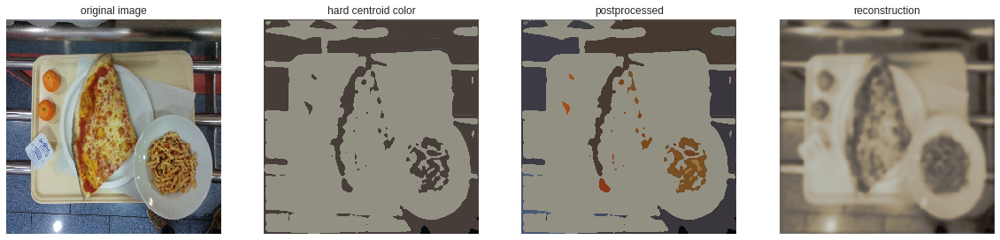

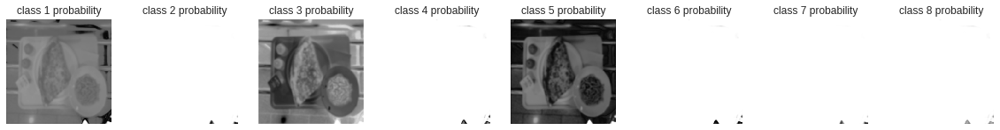

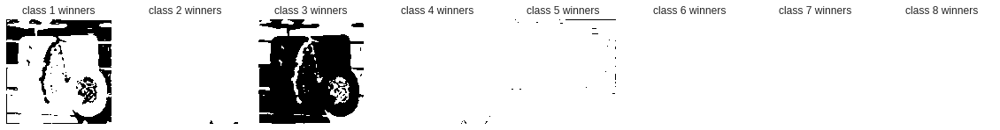

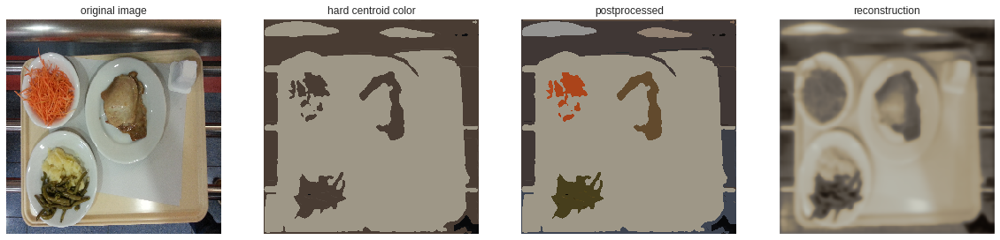

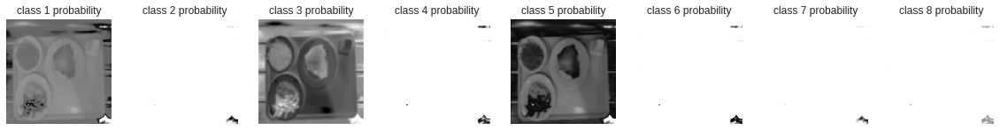

...

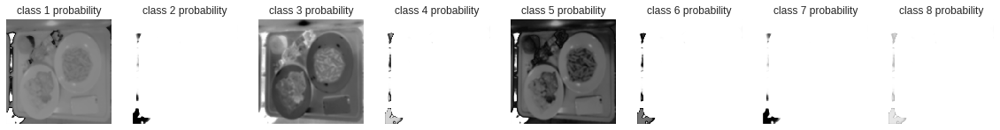

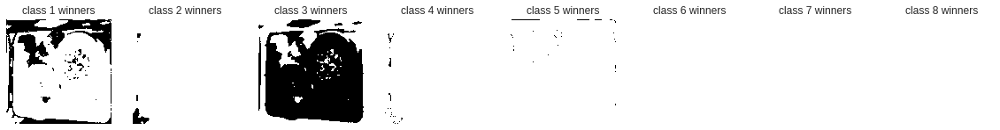

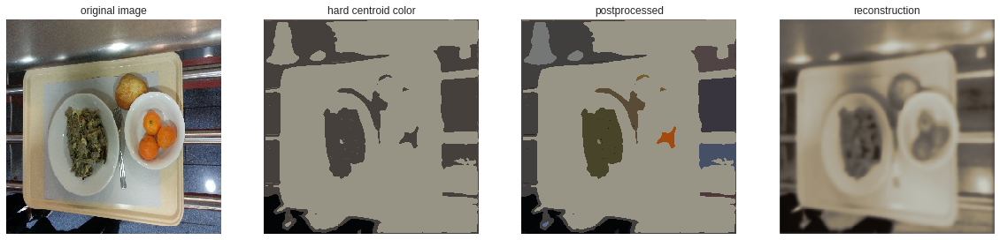

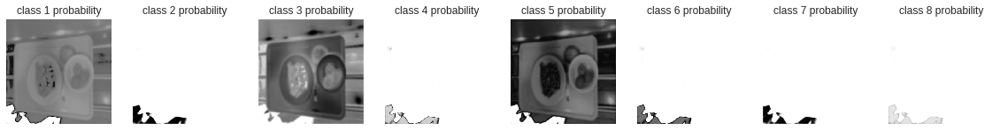

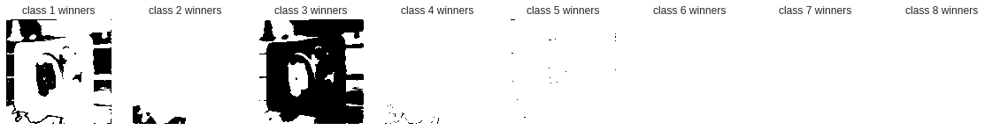

In [80]:
test_images=[]
for i in [0,1,2,3,4,5,6,7]:  
  imgee = np.zeros((1,256,256,3))
  im = imread('data/original/' + test_ids[i] + '.jpg')[:,:,:3]
  im = resize(im, (256, 256), mode='constant')
  imgee[0] = im
  y_s = w_net.predict(imgee,batch_size=1)
  segm = y_s[0][0]
  rec = y_s[1][0]
  paints(imgee[0],segm,rec)
  test_images.append(segm)

#### Compute IOU

In [19]:
suma = 0
for i in [0,1,2,3,4,5,6,7]: 
  im = imread('data/original/' + test_ids[i] + '.jpg')[:,:,:3]
  im = resize(im, (256, 256), mode='constant') 
  len(test_images)
  suma = suma+segmentation_IOU(im, test_images[i], i)
print("IOU for W-net 18-64: {}".format(suma/8))

IOU for W-net 18-64: 0.2918057304601978


#### Contour Visualization

In [81]:
for i in [0,1,2,3,4,5,6,7]: 
  im = imread('data/original/' + test_ids[i] + '.jpg')[:,:,:3]
  im = resize(im, (256, 256), mode='constant') 
  P = get_connectivity_split(img, test_images[i])
  plot_comparison_contours(test_ids[i], P)

### W-net 18-32

In [20]:
def get_wnet_18_32(IMG_WIDTH=256,IMG_HEIGHT=256,IMG_CHANNELS=3, k=CLASSES):#(shape, k=10)
  #IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS = shape
  keras.layers.BatchNormalization(axis=-1, momentum=0.99, epsilon=0.001, center=True, scale=True, beta_initializer='zeros', gamma_initializer='ones', moving_mean_initializer='zeros', moving_variance_initializer='ones', beta_regularizer=None, gamma_regularizer=None, beta_constraint=None, gamma_constraint=None)

  inputs = Input((IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS))
  s = Lambda(lambda x: x / 255) (inputs)    
  #1
  rn = keras.initializers.RandomNormal(mean=0.0, stddev=0.5, seed=25)
  conv1 = Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same') (s)
  conv1 = Dropout(0.2)(conv1) 
  conv1 = Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same') (conv1)
  p1 = MaxPooling2D((2,2)) (conv1)

  #2
  sconv2 =SeparableConv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p1)
  sconv2 = Dropout(0.2)(sconv2) 
  sconv2 =SeparableConv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(sconv2)
  p2 = MaxPooling2D((2,2)) (sconv2)

  #3
  sconv3 = SeparableConv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p2)
  sconv3 = Dropout(0.2)(sconv3) 
  sconv3 = SeparableConv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(sconv3)
  p3 = MaxPooling2D((2, 2)) (sconv3)

  #4
  sconv4 = SeparableConv2D(256, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p3)
  sconv4 = Dropout(0.2)(sconv4) 
  sconv4 = SeparableConv2D(256, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(sconv4)
  p4 = MaxPooling2D((2, 2)) (sconv4)

  #5
  sc5 = SeparableConv2D(512, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p4)
  sc5 = Dropout(0.2)(sc5) 
  sc5 = SeparableConv2D(512, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(sc5)

  #6
  l6 = Conv2DTranspose(256, (2, 2), strides=(2, 2), padding='same')(sc5)
  l6 = concatenate([sconv4, l6])
  l6 = SeparableConv2D(256, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(l6)
  l6 = Dropout(0.2)(l6) 
  l6 = SeparableConv2D(256, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(l6)

  #7
  l7 = Conv2DTranspose(128, (2, 2), strides=(2, 2), padding='same')(l6)
  l7 = concatenate([sconv3, l7])
  l7 = SeparableConv2D(128 , (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(l7)
  l7 = Dropout(0.2)(l7)
  l7 = SeparableConv2D(128 , (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(l7)

  #8
  l8 = Conv2DTranspose(64, (2, 2), strides=(2, 2), padding='same')(l7)
  l8 = concatenate([sconv2, l8])
  l8 = SeparableConv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(l8)
  l8 = Dropout(0.2)(l8) 
  l8 = SeparableConv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(l8)

  #9
  l9 = Conv2DTranspose(32 ,(2, 2), strides=(2, 2), padding='same')(l8)
  l9 = concatenate([conv1, l9])
  l9 = Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same') (l9)
  l9 = Dropout(0.2)(l9) 
  l9 = Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same') (l9)
  output1 = Conv2D(k, (1, 1), activation='softmax', kernel_initializer=rn, padding='same', name='segmentation') (l9)
  #----------------------------------------------------------------------
  #soft n-cut loss
  #10
  conv10 = Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same') (output1)
  conv10 = Dropout(0.2)(conv10) 
  conv10 = Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same') (conv10)
  p10 = MaxPooling2D(pool_size=(2, 2))  (conv10)

  #11
  sconv11 = SeparableConv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p10)
  sconv11 = Dropout(0.2)(sconv11) 
  sconv11 = SeparableConv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(sconv11)
  p11 = MaxPooling2D(pool_size=(2, 2))  (sconv11)

  #12
  sconv12 = SeparableConv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p11)
  sconv12 = Dropout(0.2)(sconv12) 
  sconv12 = SeparableConv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(sconv12)
  p12 = MaxPooling2D(pool_size=(2, 2))  (sconv12)

  #13
  sconv13 = SeparableConv2D(256, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p12)
  sconv13 = Dropout(0.2)(sconv13) 
  sconv13 = SeparableConv2D(256, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(sconv13)
  p13 = MaxPooling2D(pool_size=(2, 2)) (sconv13)

  #14
  sc14 = SeparableConv2D(512, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p13)
  sc14 = Dropout(0.2)(sc14)
  sc14 = SeparableConv2D(512, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(sc14)

  #15
  l15 = Conv2DTranspose(256, (2, 2), strides=(2, 2), padding='same')(sc14)
  l15 = concatenate([sconv13, l15])
  l15 = SeparableConv2D(256, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(l15)
  l15 = Dropout(0.2)(l15) 
  l15 = SeparableConv2D(256, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(l15)

  #16
  l16 = Conv2DTranspose(128,(2, 2), strides=(2, 2), padding='same')(l15)
  l16 = concatenate([sconv12, l16])
  l16 = SeparableConv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(l16)
  l16 = Dropout(0.2)(l16) 
  l16 = SeparableConv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(l16)

  #17
  l17 = Conv2DTranspose(64, (2, 2), strides=(2, 2), padding='same')(l16)
  l17 = concatenate([sconv11, l17])
  l17 = SeparableConv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(l17)
  l17 = Dropout(0.2)(l17) 
  l17 = SeparableConv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(l17)

  #18
  l18 = Conv2DTranspose(32, (2, 2), strides=(2, 2), padding='same')(l17)
  l18 = concatenate([conv10, l18])
  l18 = Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same') (l18)
  l18 = Dropout(0.2)(l18) 
  l18 = Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same') (l18)
  output2 = Conv2D(3, (1, 1), activation='sigmoid', kernel_initializer='he_normal', padding='same', name='reconstruction') (l18)
  Adam = keras.optimizers.Adam(lr=0.0005, beta_1=0.9, beta_2=0.999, epsilon=None, decay=0.03)
  model = Model(inputs=[inputs], outputs=[output1, output2])
  model.compile(optimizer=Adam,loss={'segmentation': centroids_similarity_loss, 'reconstruction': 'binary_crossentropy'}, metrics=['accuracy'])
  return model

In [21]:
w_net = get_wnet_18_32()

#### train data 

Training 

In [0]:
history = w_net.fit(img[:,:,:,:3],[img, img[:,:,:,:3]],epochs=500, batch_size=10,verbose=1)

One image processing

In [0]:
segmentation2 = []
reconstruction2 = []
suma2 = []
for i in range(200):
  history = w_net.fit(img[:,:,:,:3],[img,img[:,:,:,:3]],epochs=1, batch_size=1,verbose=0)
  y_s = w_net.predict(img[:,:,:,:3],batch_size=1 , verbose=0)
  segm = y_s[0][0]
  rec = y_s[1][0]
  losses = w_net.evaluate(img[:,:,:,:3],[img,img[:,:,:,:3]], batch_size=1,verbose=0)
  segmentation2.append(losses[1])
  reconstruction2.append(losses[2])
  suma2.append(losses[0])
  if i%10==0:
    print(i)
    paints(img[0],segm,rec)
plt.plot(segmentation2)
plt.plot(reconstruction2)
plt.plot(suma2)
plt.title('model double loss')
plt.ylabel('losses value')
plt.xlabel('epoch')
plt.legend(['segmentation loss','reconstruction loss','model loss'], loc='upper left')
plt.show()

#### prediction

In [0]:
for i in [0,1,2,3,4,5,6,7]:  
  imgee = np.zeros((1,256,256,3))
  im = imread('data/original/' + test_ids[i] + '.jpg')[:,:,:3]
  im = resize(im, (256, 256), mode='constant')
  imgee[0] = im
  y_s = w_net.predict(imgee,batch_size=1)
  segm = y_s[0][0]
  rec = y_s[1][0]
  paints(imgee[0],segm,rec)

#### Contour Visualization

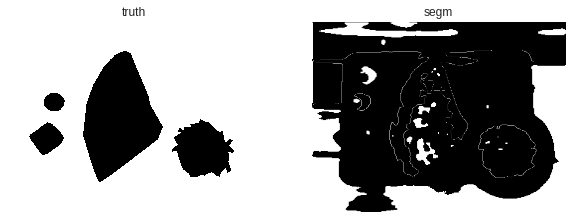

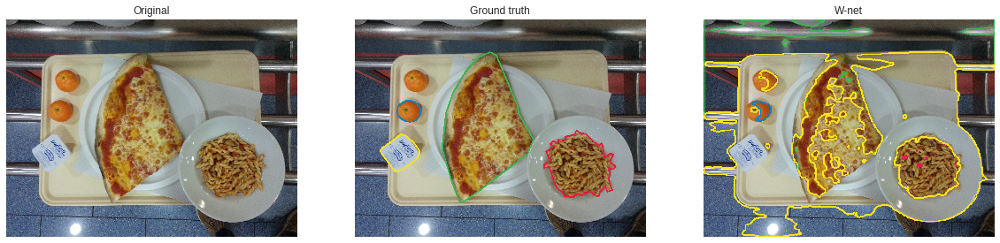

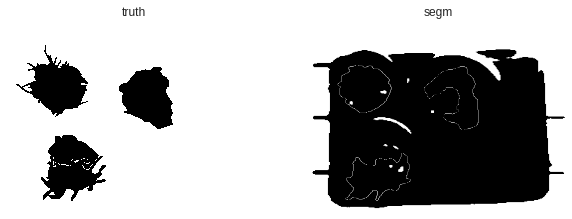

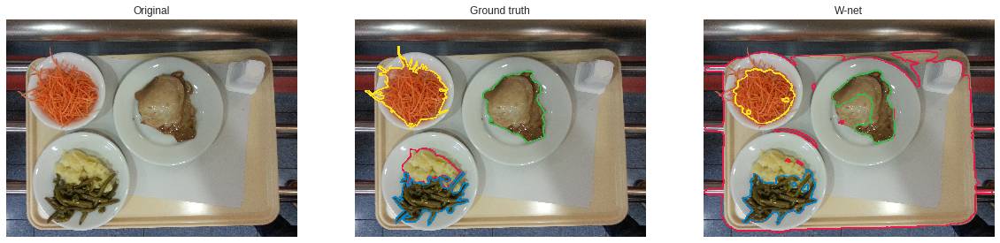

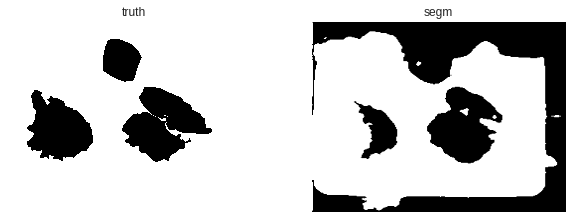

...

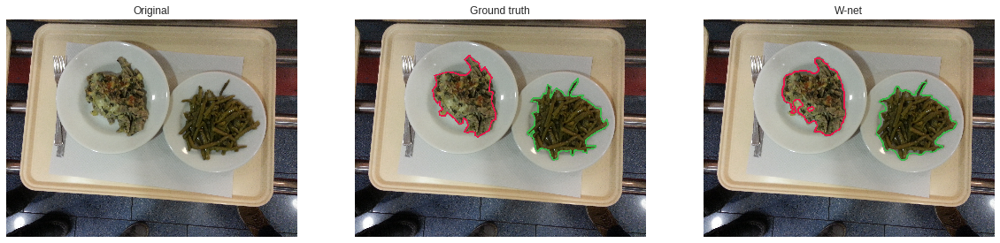

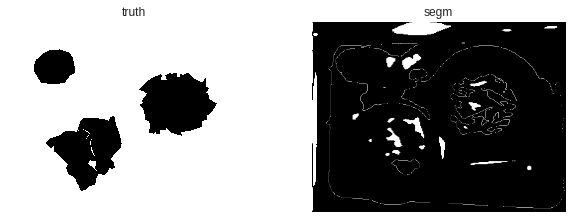

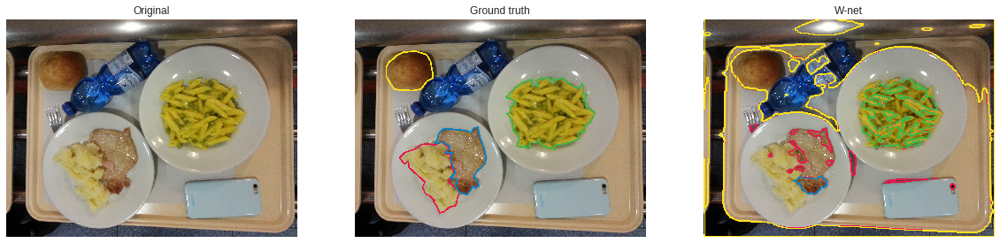

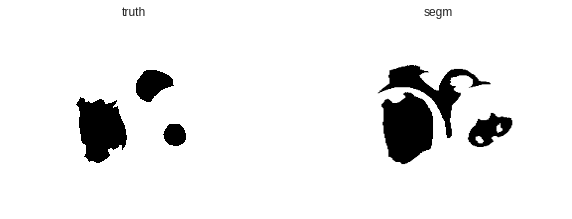

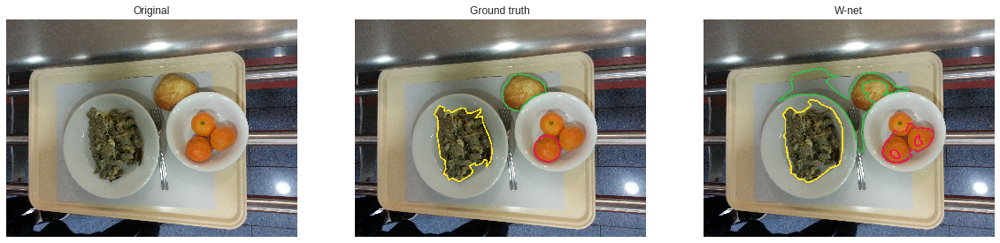

In [47]:
for i in [0,1,2,3,4,5,6,7]: 
  im = imread('data/original/' + test_ids[i] + '.jpg')[:,:,:3]
  im = resize(im, (256, 256), mode='constant') 
  P = get_connectivity_split(img, test_images[i])
  plot_comparison_contours(test_ids[i], P)

#### IOU computation

In [24]:
suma = 0
for i in [0,1,2,3,4,5,6,7]: 
  im = imread('data/original/' + test_ids[i] + '.jpg')[:,:,:3]
  im = resize(im, (256, 256), mode='constant') 
  len(test_images)
  suma = suma+segmentation_IOU(im, test_images[i], i)
print("IOU for W-net 18-64: {}".format(suma/8))

IOU for W-net 18-64: 0.5248896823344873


### W-net 14-64

In [25]:
def get_wnet_14_64(IMG_WIDTH=256,IMG_HEIGHT=256,IMG_CHANNELS=3, k=CLASSES):#(shape, k=10)
#    IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS = shape
  inputs = Input((IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS))
  s = Lambda(lambda x: x / 255) (inputs)    
  #1
  conv1 = Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same') (s)
  conv1 = Dropout(0.65)(conv1)
  conv1 = Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same') (conv1)
  p1 = MaxPooling2D((2,2)) (conv1)

  #2
  sconv2 = SeparableConv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p1)
  sconv2 = Dropout(0.65)(sconv2)
  sconv2 = SeparableConv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(sconv2)
  p2 = MaxPooling2D((2, 2)) (sconv2)

  #3
  sconv3 = SeparableConv2D(256, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p2)
  sconv3 = Dropout(0.65)(sconv3)
  sconv3 = SeparableConv2D(256, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(sconv3)
  p3 = MaxPooling2D((2, 2)) (sconv3)
  
  #4
  sc4 = SeparableConv2D(512, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p3)
  sc4 = Dropout(0.65)(sc4)
  sc4 = SeparableConv2D(512, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(sc4)

  #5
  l3 = Conv2DTranspose(256, (2, 2), strides=(2, 2), padding='same')(sc4)
  l3 = concatenate([sconv3, l3])
  l3 = SeparableConv2D(256 , (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(l3)
  l3 = Dropout(0.65)(l3)
  l3 = SeparableConv2D(256 , (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(l3)
  
  #6
  l4 = Conv2DTranspose(128, (2, 2), strides=(2, 2), padding='same')(l3)
  l4 = concatenate([sconv2, l4])
  l4 = SeparableConv2D(128 , (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(l4)
  l4 = Dropout(0.65)(l4)
  l4 = SeparableConv2D(128 , (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(l4) 
  
  #7
  l6 = Conv2DTranspose(64 ,(2, 2), strides=(2, 2), padding='same')(l4)
  l6 = concatenate([conv1, l6])
  l6 = Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same') (l6)
  l6 = Dropout(0.65)(l6)
  l6 = Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same') (l6)
  output1 = Conv2D(k, (1, 1), activation='softmax', kernel_initializer='he_normal', padding='same', name='segmentation') (l6)
  #----------------------------------------------------------------------
  #soft n-cut loss
  #8
  conv4 = Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(output1)
  conv4 = Dropout(0.65)(conv4)
  conv4 = Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(conv4)
  p5 = MaxPooling2D(pool_size=(2, 2))(conv4)


  #9
  sconv5 = SeparableConv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p5)
  sconv5 = Dropout(0.65)(sconv5) 
  sconv5 = SeparableConv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(sconv5)
  p5 = MaxPooling2D(pool_size=(2, 2)) (sconv5)

  #10
  sconv6 = SeparableConv2D(256, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p5)
  sconv6 = Dropout(0.65)(sconv6) 
  sconv6 = SeparableConv2D(256, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(sconv6)
  p6 = MaxPooling2D(pool_size=(2, 2)) (sconv6)
  
  #11
  sc7 = SeparableConv2D(512, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p6)
  sc7 = Dropout(0.65)(sc7) 
  sc7 = SeparableConv2D(512, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(sc7)

  #12
  l7 = Conv2DTranspose(256, (2, 2), strides=(2, 2), padding='same')(sc7)
  l7 = concatenate([sconv6, l7])
  l7 = SeparableConv2D(256, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(l7)
  sconv6 = Dropout(0.65)(l7)
  l7 = SeparableConv2D(256, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(l7)
  
  #13
  l8 = Conv2DTranspose(128, (2, 2), strides=(2, 2), padding='same')(l7)
  l8 = concatenate([sconv5, l8])
  l8 = SeparableConv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(l8)
  sconv6 = Dropout(0.65)(l8)
  l8 = SeparableConv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(l8)

  #14
  l9 = Conv2DTranspose(64, (2, 2), strides=(2, 2), padding='same')(l8)
  l9 = concatenate([conv4, l9])
  l9 = Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same') (l9)
  sconv6 = Dropout(0.65)(l9)
  l9 = Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same') (l9)
  output2 = Conv2D(3, (1, 1), activation='sigmoid', kernel_initializer='he_normal', padding='same', name='reconstruction') (l9)
  Adam = keras.optimizers.Adam(lr=0.0005, beta_1=0.9, beta_2=0.999, epsilon=None, decay=0.03)
  model = Model(inputs=[inputs], outputs=[output1, output2])
  model.compile(optimizer='adam',loss={'segmentation': centroids_similarity_loss, 'reconstruction': 'binary_crossentropy'}, metrics=['accuracy'])
  return model

In [26]:
w_net = get_wnet_14_64()

#### train data 

Training 

In [0]:
history = w_net.fit(img[:,:,:,:3],[img, img[:,:,:,:3]],epochs=500, batch_size=10,verbose=1)

One image processing

0


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in true_divide


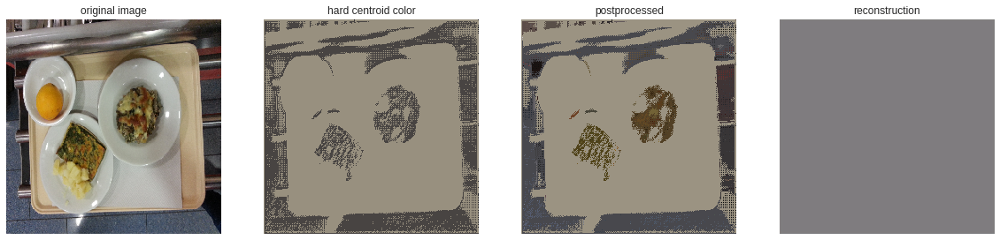

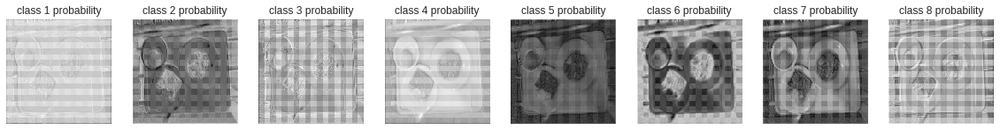

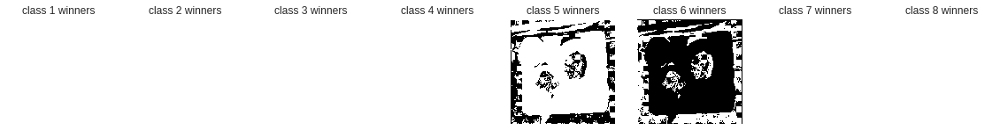

10


/usr/local/lib/python3.6/dist-packages/numpy/core/_methods.py:29: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims)


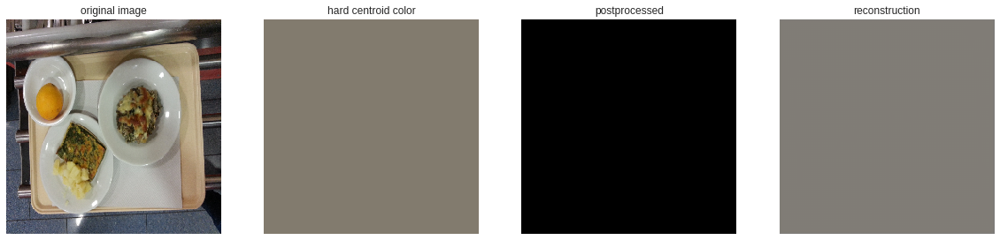

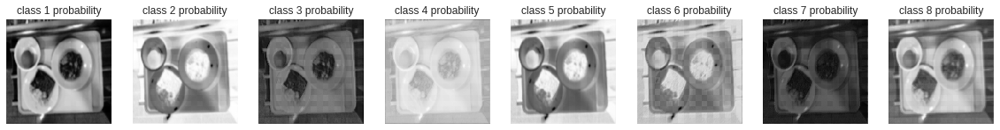

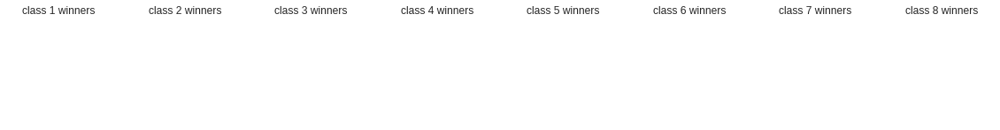

20


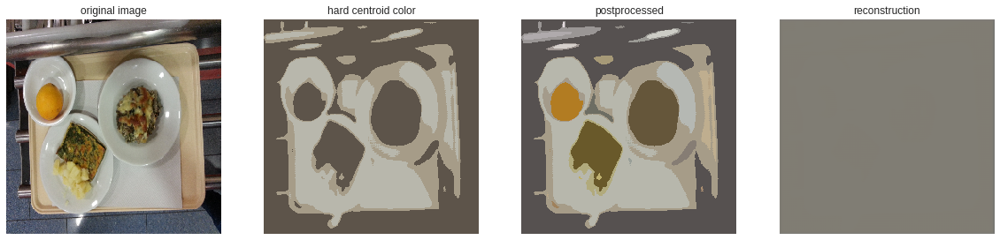

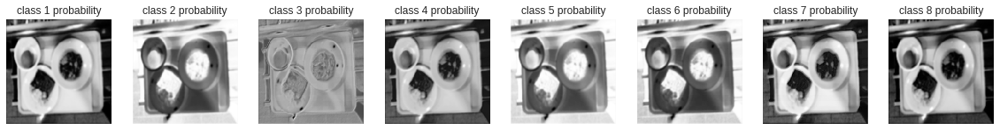

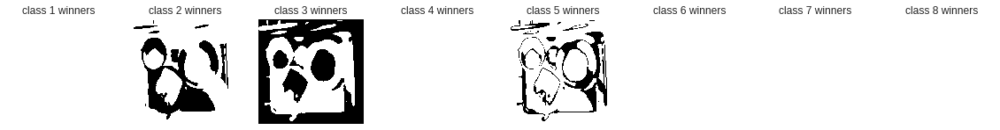

30


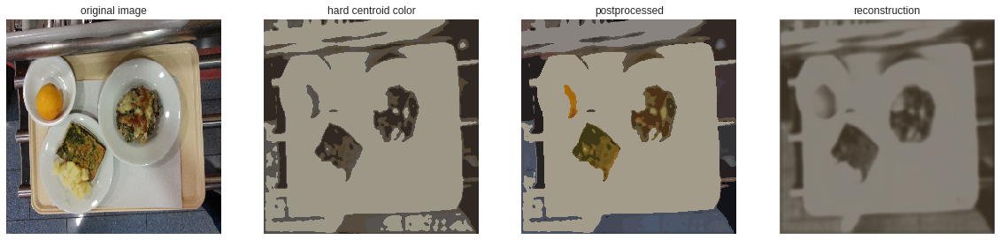

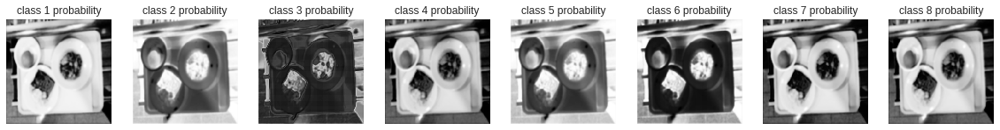

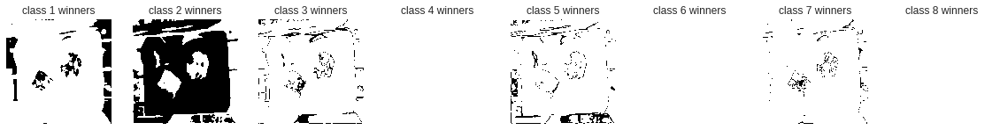

40


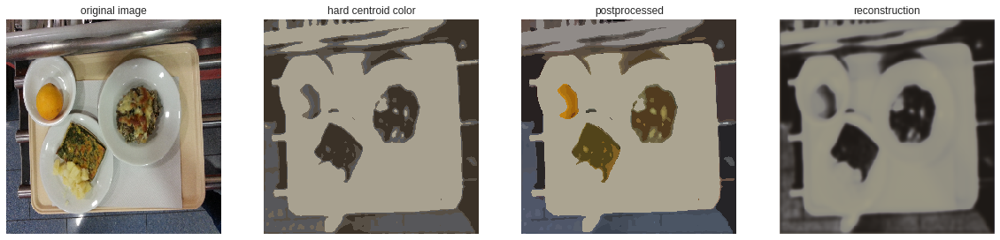

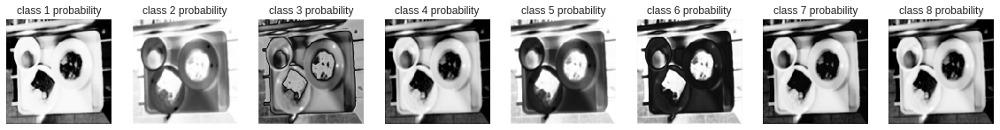

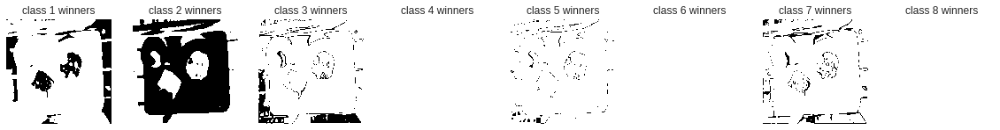

50


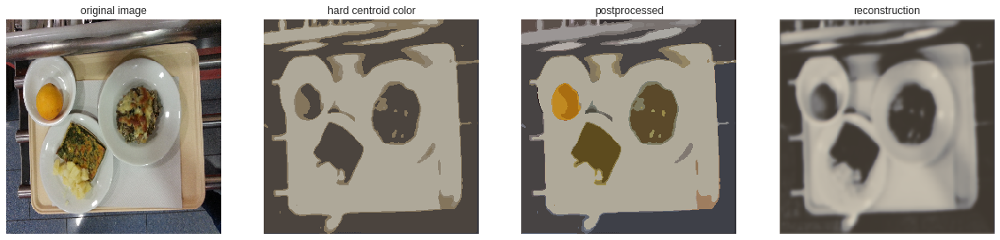

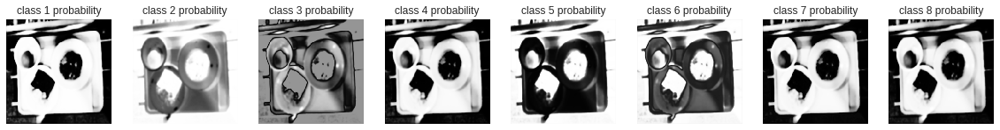

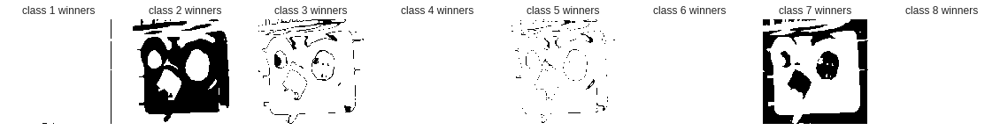

60


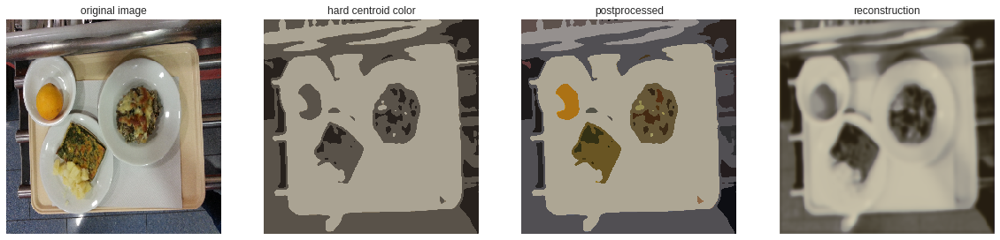

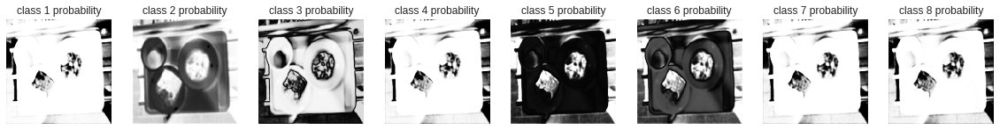

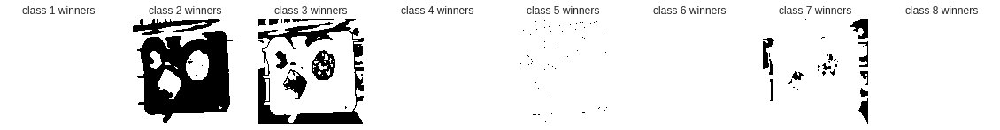

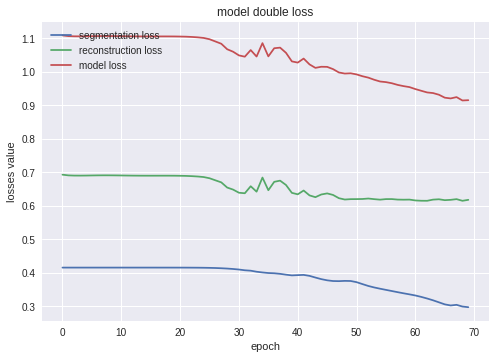

In [48]:
segmentation3 = []
reconstruction3= []
suma3 = []
for i in range(200):
  history = w_net.fit(img[:,:,:,:3],[img,img[:,:,:,:3]],epochs=1, batch_size=1,verbose=0)
  y_s = w_net.predict(img[:,:,:,:3],batch_size=1 , verbose=0)
  segm = y_s[0][0]
  rec = y_s[1][0]
  losses = w_net.evaluate(img[:,:,:,:3],[img,img[:,:,:,:3]], batch_size=1,verbose=0)
  segmentation3.append(losses[1])
  reconstruction3.append(losses[2])
  suma3.append(losses[0])
  if i%10==0:
    print(i)
    paints(img[0],segm,rec)
plt.plot(segmentation3)
plt.plot(reconstruction3)
plt.plot(suma3)
plt.title('model double loss')
plt.ylabel('losses value')
plt.xlabel('epoch')
plt.legend(['segmentation loss','reconstruction loss','model loss'], loc='upper left')
plt.show()

#### prediction

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in true_divide


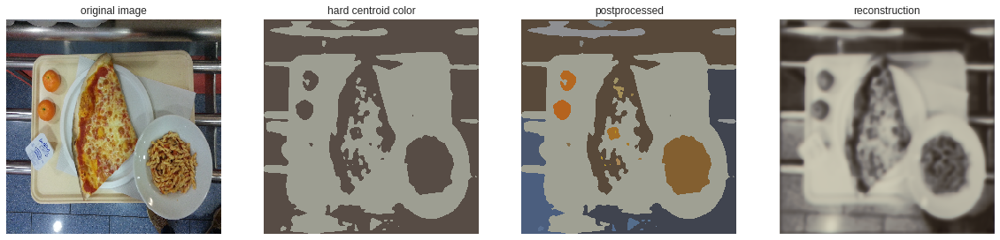

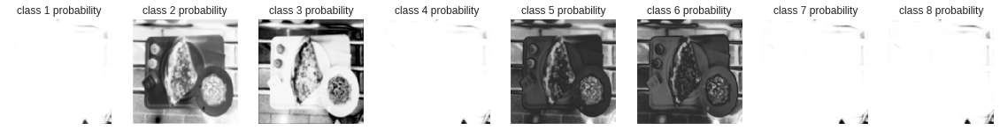

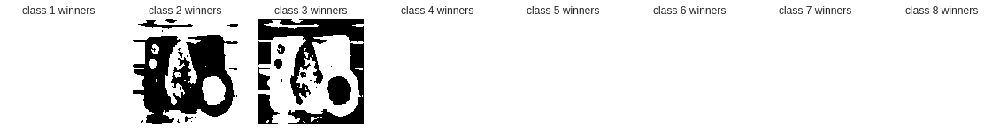

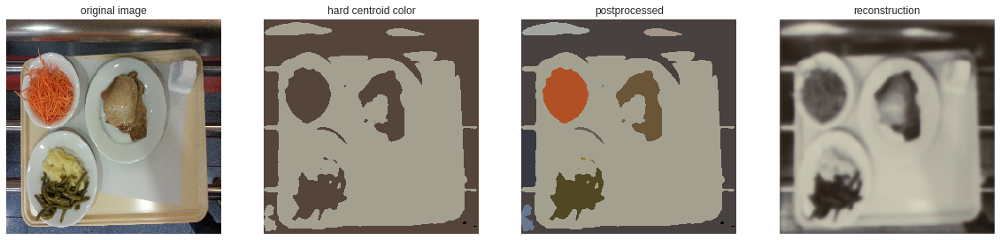

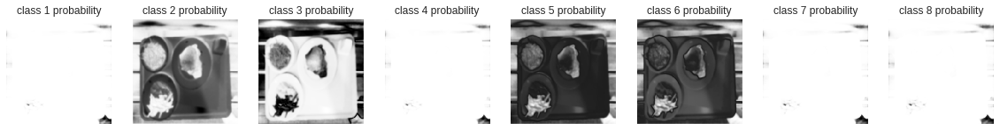

...

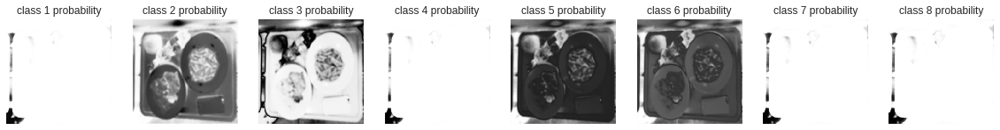

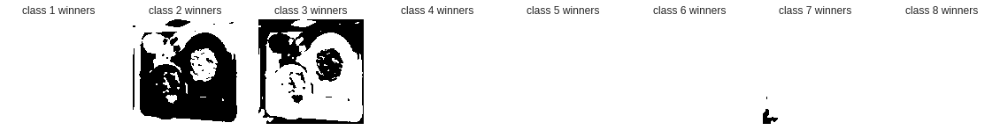

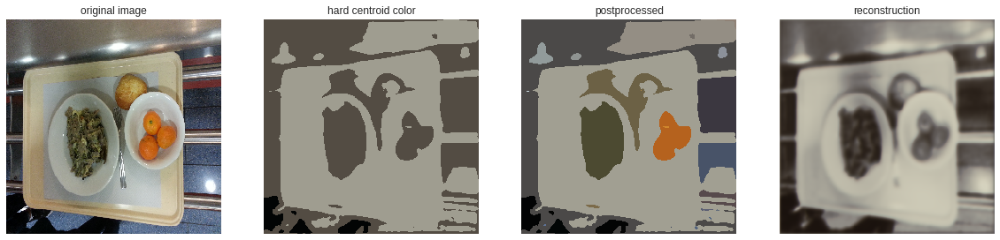

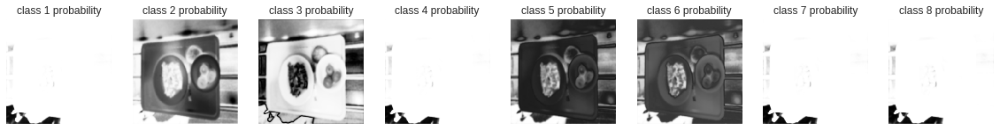

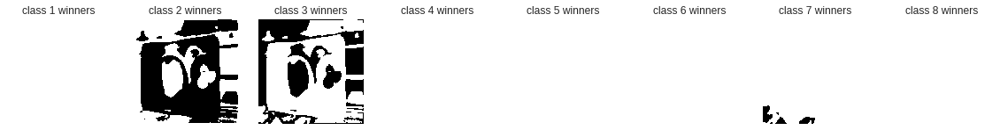

In [49]:
test_images=[]
for i in [0,1,2,3,4,5,6,7]:  
  imgee = np.zeros((1,256,256,3))
  im = imread('data/original/' + test_ids[i] + '.jpg')[:,:,:3]
  im = resize(im, (256, 256), mode='constant')
  imgee[0] = im
  y_s = w_net.predict(imgee,batch_size=1)
  segm = y_s[0][0]
  rec = y_s[1][0]
  paints(imgee[0],segm,rec)
  test_images.append(segm)

#### IOU computation

In [30]:
suma = 0
for i in [0,1,2,3,4,5,6,7]: 
  im = imread('data/original/' + test_ids[i] + '.jpg')[:,:,:3]
  im = resize(im, (256, 256), mode='constant') 
  len(test_images)
  suma = suma+segmentation_IOU(im, test_images[i], i)
print("IOU for W-net 14-64: {}".format(suma/8))

IOU for W-net 14-64: 0.3674015090833691


#### Contour Visualization

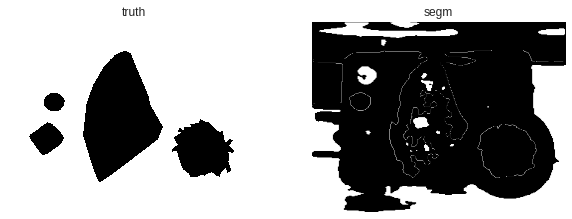

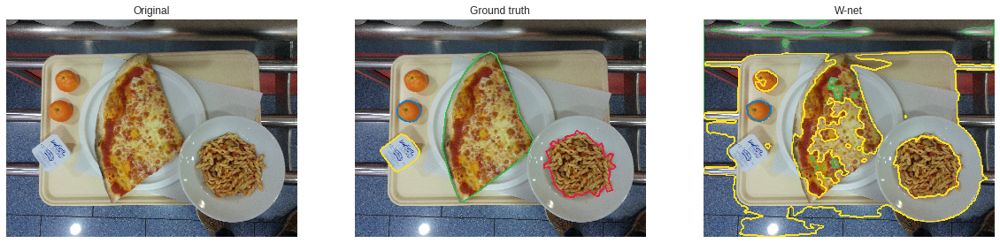

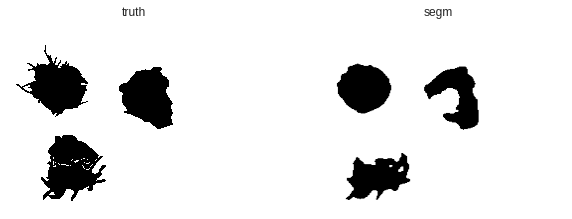

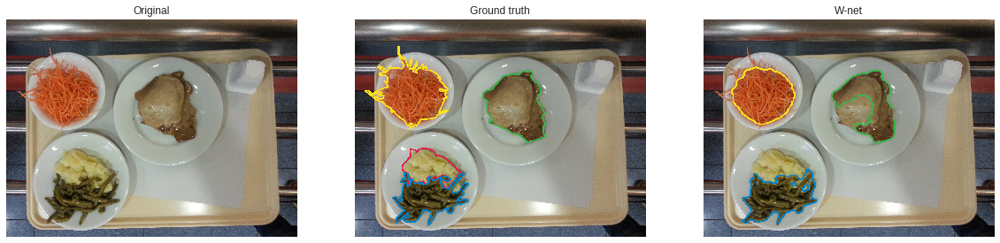

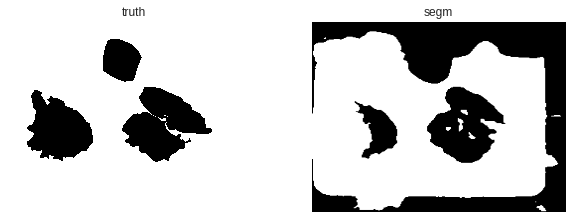

...

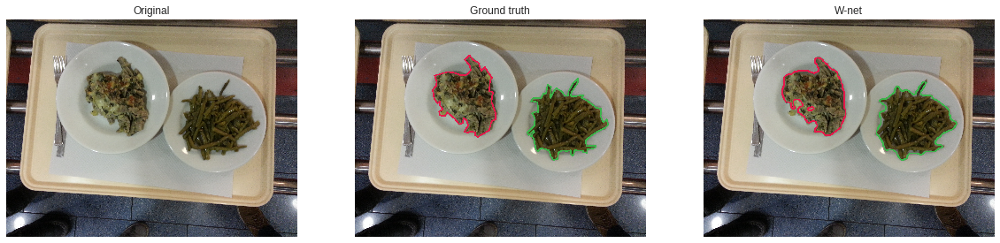

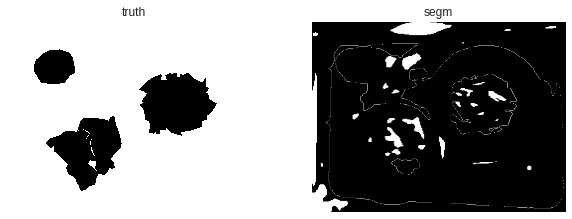

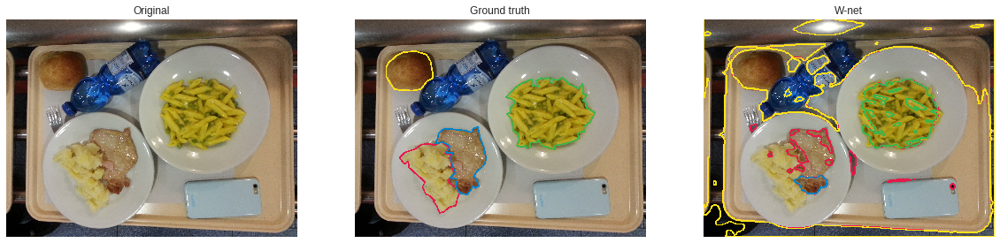

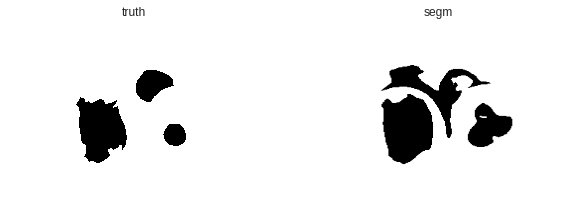

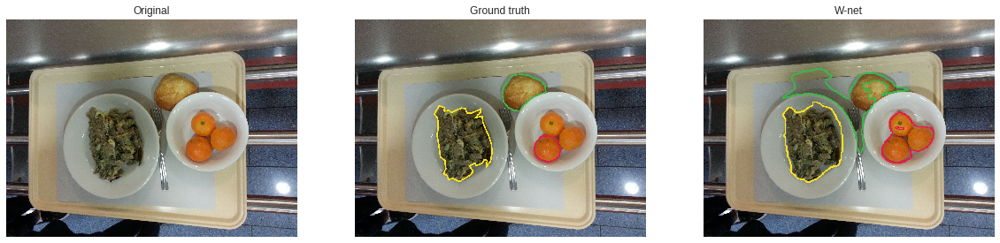

In [51]:
for i in [0,1,2,3,4,5,6,7]: 
  im = imread('data/original/' + test_ids[i] + '.jpg')[:,:,:3]
  im = resize(im, (256, 256), mode='constant') 
  P = get_connectivity_split(img, test_images[i])
  plot_comparison_contours(test_ids[i], P)

### W-net 10-64

In [32]:
def get_small_wnet_10_64(IMG_WIDTH=256,IMG_HEIGHT=256,IMG_CHANNELS=3, k=CLASSES):#(shape, k=10)
#    IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS = shape
  inputs = Input((IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS))
  s = Lambda(lambda x: x / 255) (inputs)    
  #1
  conv1 = Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same') (s)
  conv1 = Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same') (conv1)
  p1 = MaxPooling2D((2,2)) (conv1)

  #2
  sconv2 = SeparableConv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p1)
  sconv2 = SeparableConv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(sconv2)
  p3 = MaxPooling2D((2, 2)) (sconv2)

  #3
  sc3 = SeparableConv2D(256, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p3)
  sc3 = SeparableConv2D(256, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(sc3)

  #4
  l4 = Conv2DTranspose(128, (2, 2), strides=(2, 2), padding='same')(sc3)
  l4 = concatenate([sconv2, l4])
  l4 = SeparableConv2D(128 , (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(l4)
  l4 = SeparableConv2D(128 , (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(l4)

  #5
  l5 = Conv2DTranspose(64 ,(2, 2), strides=(2, 2), padding='same')(l4)
  l5 = concatenate([conv1, l5])
  l5 = Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same') (l5)
  l5 = Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same') (l5)
  output1 = Conv2D(k, (1, 1), activation='softmax', kernel_initializer='he_normal', padding='same', name='segmentation') (l5)
  #----------------------------------------------------------------------
  #soft n-cut loss
  #6
  conv5 = Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same') (output1)
  conv5 = Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same') (conv5)
  p5 = MaxPooling2D(pool_size=(2, 2))  (conv5)


  #4+9
  sconv6 = SeparableConv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p5)
  sconv6 = SeparableConv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(sconv6)
  p6 = MaxPooling2D(pool_size=(2, 2)) (sconv6)

  #5+9
  sc7 = SeparableConv2D(256, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p6)
  sc7 = SeparableConv2D(256, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(sc7)

  #6+9
  l8 = Conv2DTranspose(128, (2, 2), strides=(2, 2), padding='same')(sc7)
  l8 = concatenate([sconv6, l8])
  l8 = SeparableConv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(l8)
  l8 = SeparableConv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(l8)

  #9+9
  l9 = Conv2DTranspose(64, (2, 2), strides=(2, 2), padding='same')(l8)
  l9 = concatenate([conv5, l9])
  l9 = Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same') (l9)
  l9 = Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same') (l9)
  output2 = Conv2D(3, (1, 1), activation='sigmoid', kernel_initializer='he_normal', padding='same', name='reconstruction') (l9)
  Adam = keras.optimizers.Adam(lr=0.0005, beta_1=0.9, beta_2=0.999, epsilon=None, decay=0.03)
  model = Model(inputs=[inputs], outputs=[output1, output2])
  model.compile(optimizer='adam',loss={'segmentation': centroids_similarity_loss, 'reconstruction': 'binary_crossentropy'}, metrics=['accuracy'])
  return model

In [33]:
w_net = get_small_wnet_10_64()

#### train data 



Training

In [0]:
history = w_net.fit(img[:,:,:,:3],[img, img[:,:,:,:3]],epochs=500, batch_size=10,verbose=1)

One image processing

In [0]:
segmentation4 = []
reconstruction4 = []
suma4 = []
for i in range(200):
  history = w_net.fit(img[:,:,:,:3],[img,img[:,:,:,:3]],epochs=1, batch_size=1,verbose=0)
  y_s = w_net.predict(img[:,:,:,:3],batch_size=1 , verbose=0)
  segm = y_s[0][0]
  rec = y_s[1][0]
  losses = w_net.evaluate(img[:,:,:,:3],[img,img[:,:,:,:3]], batch_size=1,verbose=0)
  segmentation4.append(losses[1])
  reconstruction4.append(losses[2])
  suma4.append(losses[0])
  if i%10==0:
    print(i)
    paints(img[0],segm,rec)
plt.plot(segmentation4)
plt.plot(reconstruction4)
plt.plot(suma4)
plt.title('model double loss')
plt.ylabel('losses value')
plt.xlabel('epoch')
plt.legend(['segmentation loss','reconstruction loss','model loss'], loc='upper left')
plt.show()

#### prediction

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in true_divide


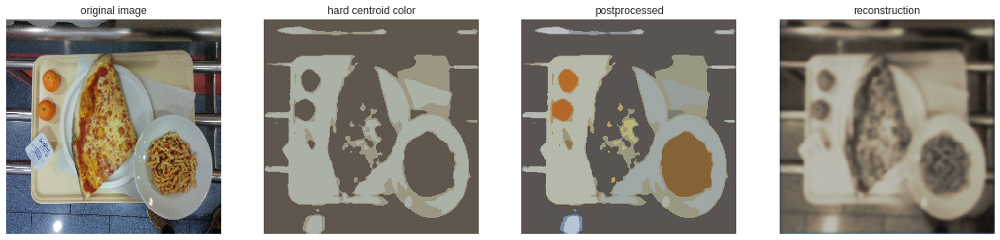

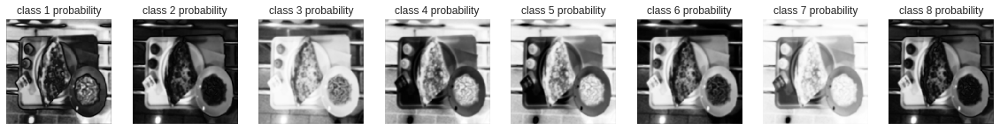

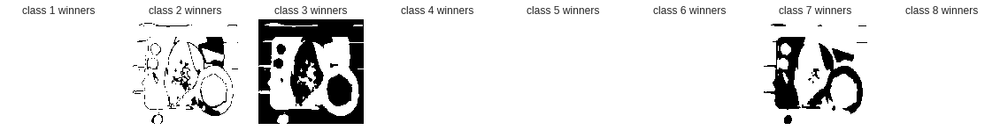

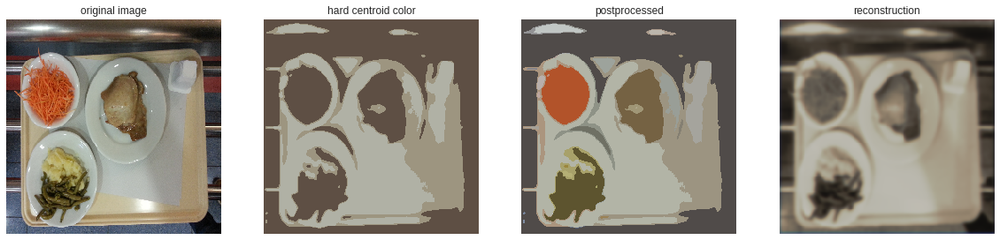

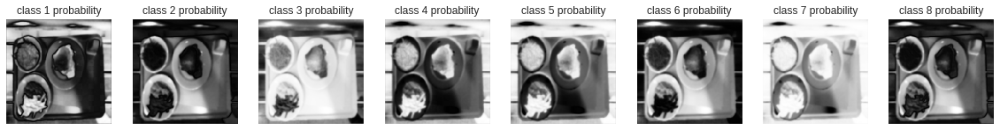

...

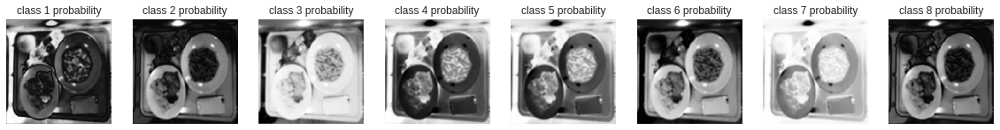

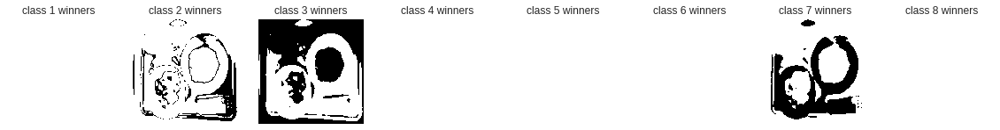

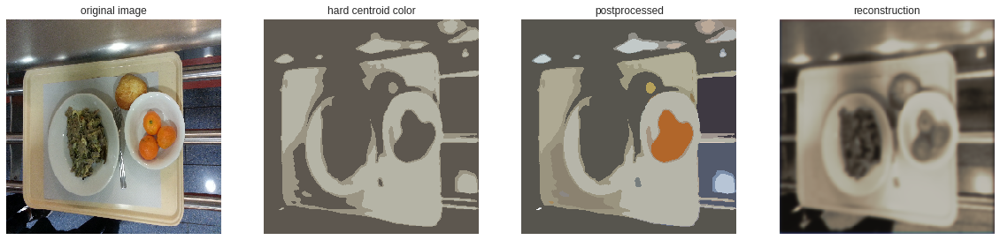

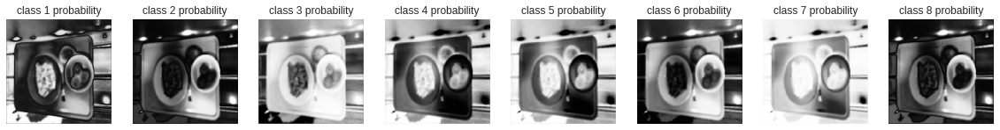

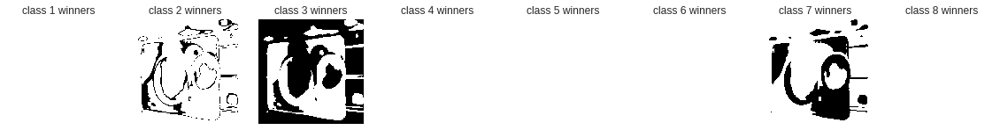

In [0]:
test_images = []
for i in [0,1,2,3,4,5,6,7]:  
  imgee = np.zeros((1,256,256,3))
  im = imread('data/original/' + test_ids[i] + '.jpg')[:,:,:3]
  im = resize(im, (256, 256), mode='constant')
  imgee[0] = im
  y_s = w_net.predict(imgee,batch_size=1)
  segm = y_s[0][0]
  rec = y_s[1][0]
  paints(imgee[0],segm,rec)
  test_images.append(segm)

#### IOU computation

In [36]:
suma = 0
for i in [0,1,2,3,4,5,6,7]: 
  im = imread('data/original/' + test_ids[i] + '.jpg')[:,:,:3]
  im = resize(im, (256, 256), mode='constant') 
  len(test_images)
  suma = suma+segmentation_IOU(im, test_images[i], i)
print("IOU for W-net 10-64: {}".format(suma/8))


IOU for W-net 10-64: 0.42851760140320505


#### Contour Visualization

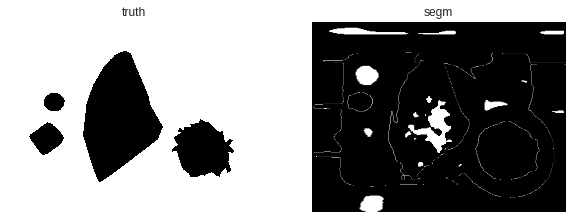

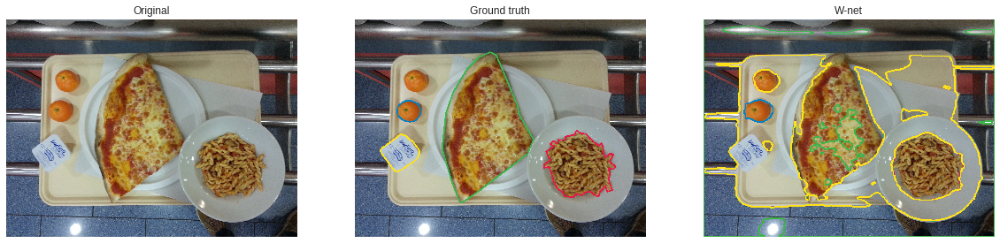

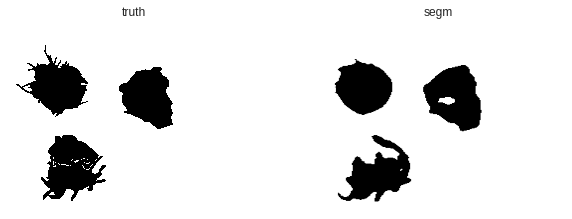

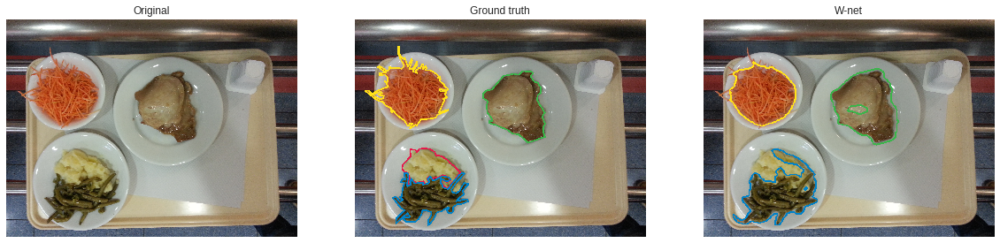

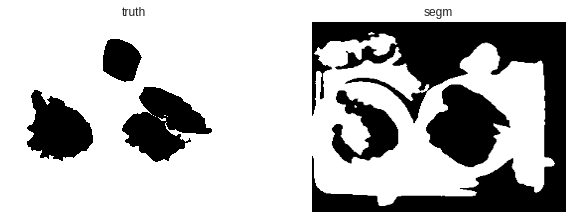

...

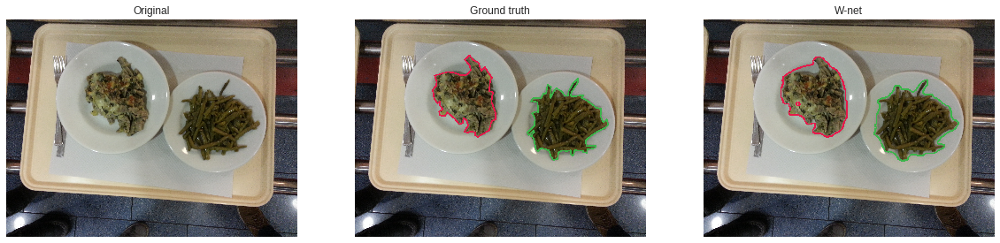

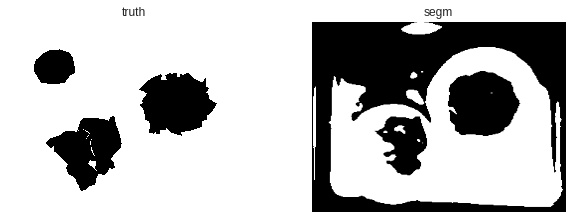

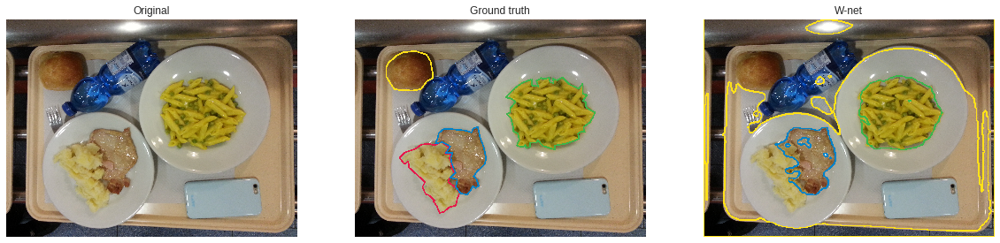

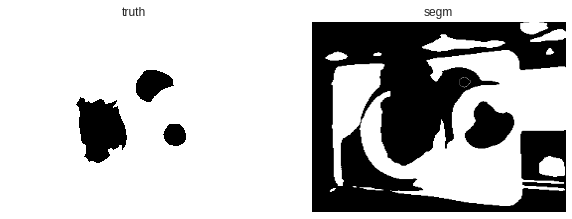

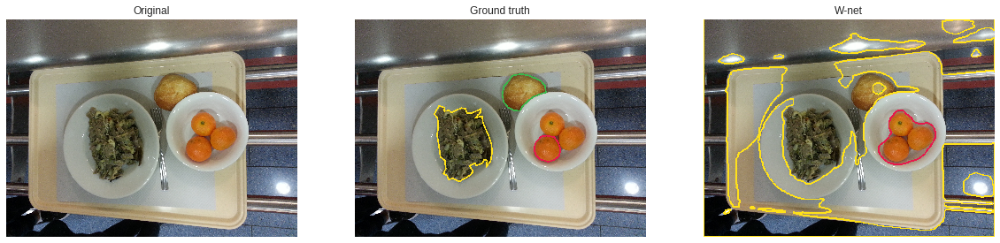

In [30]:
for i in [0,1,2,3,4,5,6,7]: 
  im = imread('data/original/' + test_ids[i] + '.jpg')[:,:,:3]
  im = resize(im, (256, 256), mode='constant') 
  P = get_connectivity_split(img, test_images[i])
  plot_comparison_contours(test_ids[i], P)

###  Plots

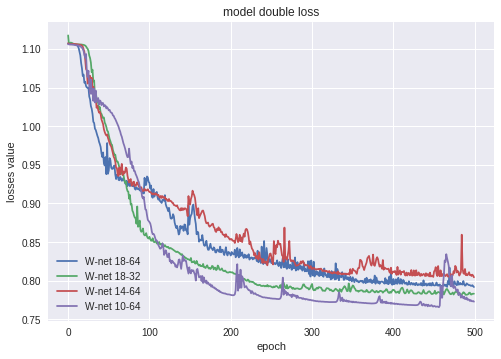

In [0]:
a = len(suma1)
plt.plot(np.arange(a),suma1)
plt.plot(np.arange(a),suma2)
plt.plot(np.arange(a),suma3)
plt.plot(np.arange(a),suma4)
plt.title('model double loss')
plt.ylabel('losses value')
plt.xlabel('epoch')
plt.legend(['W-net 18-64','W-net 18-32','W-net 14-64','W-net 10-64'], loc='lower left')
plt.show()

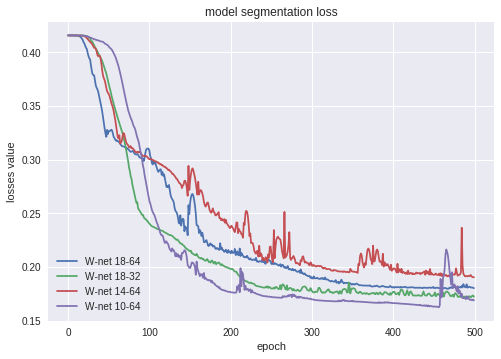

In [0]:
plt.plot(np.arange(a),segmentation1)
plt.plot(np.arange(a),segmentation2)
plt.plot(np.arange(a),segmentation3)
plt.plot(np.arange(a),segmentation4)
plt.title('model segmentation loss')
plt.ylabel('losses value')
plt.xlabel('epoch')
plt.legend(['W-net 18-64','W-net 18-32','W-net 14-64','W-net 10-64'], loc='lower left')
plt.show()

## Segmentation without using Centroid loss 

We will obtain the Visualization of the output of the final softmax layer in $U_{Enc}$
without adding the Centroid Loss  (we only have reconstruction loss in or model). 

In [50]:
def get_wnet_18_32(IMG_WIDTH=256,IMG_HEIGHT=256,IMG_CHANNELS=3, k=CLASSES):
  #IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS = shape
  keras.layers.BatchNormalization(axis=-1, momentum=0.99, epsilon=0.001, center=True, scale=True, beta_initializer='zeros', gamma_initializer='ones', moving_mean_initializer='zeros', moving_variance_initializer='ones', beta_regularizer=None, gamma_regularizer=None, beta_constraint=None, gamma_constraint=None)

  inputs = Input((IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS))
  s = Lambda(lambda x: x / 255) (inputs)    
  #1
  rn = keras.initializers.RandomNormal(mean=0.0, stddev=0.5, seed=25)
  conv1 = Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same') (s)
  conv1 = Dropout(0.2)(conv1) 
  conv1 = Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same') (conv1)
  p1 = MaxPooling2D((2,2)) (conv1)

  #2
  sconv2 =SeparableConv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p1)
  sconv2 = Dropout(0.2)(sconv2) 
  sconv2 =SeparableConv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(sconv2)
  p2 = MaxPooling2D((2,2)) (sconv2)

  #3
  sconv3 = SeparableConv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p2)
  sconv3 = Dropout(0.2)(sconv3) 
  sconv3 = SeparableConv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(sconv3)
  p3 = MaxPooling2D((2, 2)) (sconv3)

  #4
  sconv4 = SeparableConv2D(256, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p3)
  sconv4 = Dropout(0.2)(sconv4) 
  sconv4 = SeparableConv2D(256, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(sconv4)
  p4 = MaxPooling2D((2, 2)) (sconv4)

  #5
  sc5 = SeparableConv2D(512, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p4)
  sc5 = Dropout(0.2)(sc5) 
  sc5 = SeparableConv2D(512, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(sc5)

  #6
  l6 = Conv2DTranspose(256, (2, 2), strides=(2, 2), padding='same')(sc5)
  l6 = concatenate([sconv4, l6])
  l6 = SeparableConv2D(256, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(l6)
  l6 = Dropout(0.2)(l6) 
  l6 = SeparableConv2D(256, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(l6)

  #7
  l7 = Conv2DTranspose(128, (2, 2), strides=(2, 2), padding='same')(l6)
  l7 = concatenate([sconv3, l7])
  l7 = SeparableConv2D(128 , (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(l7)
  l7 = Dropout(0.2)(l7)
  l7 = SeparableConv2D(128 , (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(l7)

  #8
  l8 = Conv2DTranspose(64, (2, 2), strides=(2, 2), padding='same')(l7)
  l8 = concatenate([sconv2, l8])
  l8 = SeparableConv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(l8)
  l8 = Dropout(0.2)(l8) 
  l8 = SeparableConv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(l8)

  #9
  l9 = Conv2DTranspose(32 ,(2, 2), strides=(2, 2), padding='same')(l8)
  l9 = concatenate([conv1, l9])
  l9 = Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same') (l9)
  l9 = Dropout(0.2)(l9) 
  l9 = Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same') (l9)
  output1 = Conv2D(k, (1, 1), activation='softmax', kernel_initializer=rn, padding='same', name='segmentation') (l9)
  #----------------------------------------------------------------------
  #soft n-cut loss
  #10
  conv10 = Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same') (output1)
  conv10 = Dropout(0.2)(conv10) 
  conv10 = Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same') (conv10)
  p10 = MaxPooling2D(pool_size=(2, 2))  (conv10)

  #11
  sconv11 = SeparableConv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p10)
  sconv11 = Dropout(0.2)(sconv11) 
  sconv11 = SeparableConv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(sconv11)
  p11 = MaxPooling2D(pool_size=(2, 2))  (sconv11)

  #12
  sconv12 = SeparableConv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p11)
  sconv12 = Dropout(0.2)(sconv12) 
  sconv12 = SeparableConv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(sconv12)
  p12 = MaxPooling2D(pool_size=(2, 2))  (sconv12)

  #13
  sconv13 = SeparableConv2D(256, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p12)
  sconv13 = Dropout(0.2)(sconv13) 
  sconv13 = SeparableConv2D(256, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(sconv13)
  p13 = MaxPooling2D(pool_size=(2, 2)) (sconv13)

  #14
  sc14 = SeparableConv2D(512, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p13)
  sc14 = Dropout(0.2)(sc14)
  sc14 = SeparableConv2D(512, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(sc14)

  #15
  l15 = Conv2DTranspose(256, (2, 2), strides=(2, 2), padding='same')(sc14)
  l15 = concatenate([sconv13, l15])
  l15 = SeparableConv2D(256, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(l15)
  l15 = Dropout(0.2)(l15) 
  l15 = SeparableConv2D(256, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(l15)

  #16
  l16 = Conv2DTranspose(128,(2, 2), strides=(2, 2), padding='same')(l15)
  l16 = concatenate([sconv12, l16])
  l16 = SeparableConv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(l16)
  l16 = Dropout(0.2)(l16) 
  l16 = SeparableConv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(l16)

  #17
  l17 = Conv2DTranspose(64, (2, 2), strides=(2, 2), padding='same')(l16)
  l17 = concatenate([sconv11, l17])
  l17 = SeparableConv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(l17)
  l17 = Dropout(0.2)(l17) 
  l17 = SeparableConv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(l17)

  #18
  l18 = Conv2DTranspose(32, (2, 2), strides=(2, 2), padding='same')(l17)
  l18 = concatenate([conv10, l18])
  l18 = Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same') (l18)
  l18 = Dropout(0.2)(l18) 
  l18 = Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same') (l18)
  output2 = Conv2D(3, (1, 1), activation='sigmoid', kernel_initializer='he_normal', padding='same', name='reconstruction') (l18)
  Adagrad = keras.optimizers.Adagrad(lr=0.01, epsilon=None, decay=0.0)
  Adam = keras.optimizers.Adam(lr=0.0005, beta_1=0.9, beta_2=0.999, epsilon=None, decay=0.03)
  Nadam = keras.optimizers.Nadam(lr=0.002, beta_1=0.9, beta_2=0.999, epsilon=None, schedule_decay=0.004)
  Adamax = keras.optimizers.Adamax(lr=0.002, beta_1=0.9, beta_2=0.999, epsilon=None, decay=0.0)
  model = Model(inputs=[inputs], outputs=[output1, output2])
  model.compile(optimizer=Adam,loss={'segmentation': zero_loss, 'reconstruction': 'binary_crossentropy'}, metrics=['accuracy'])
  return model

In [51]:
w_net = get_wnet_18_32()

#### training

Training

In [0]:
history = w_net.fit(img[:,:,:,:3],[img, img[:,:,:,:3]],epochs=500, batch_size=10,verbose=1)

One image processing

In [0]:
for i in range(200):
  history = w_net.fit(img[:,:,:,:3],[img,img[:,:,:,:3]],epochs=1, batch_size=1,verbose=0)
  y_s = w_net.predict(img[:,:,:,:3],batch_size=1 , verbose=0)
  segm = y_s[0][0]
  rec = y_s[1][0]
  losses = w_net.evaluate(img[:,:,:,:3],[img,img[:,:,:,:3]], batch_size=1,verbose=0)
  segmentation1.append(losses[1])
  reconstruction1.append(losses[2])
  suma1.append(losses[0])
  if i%200==0:
    print(i)
    paints(img[0],segm,rec)

#### prediction

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in true_divide


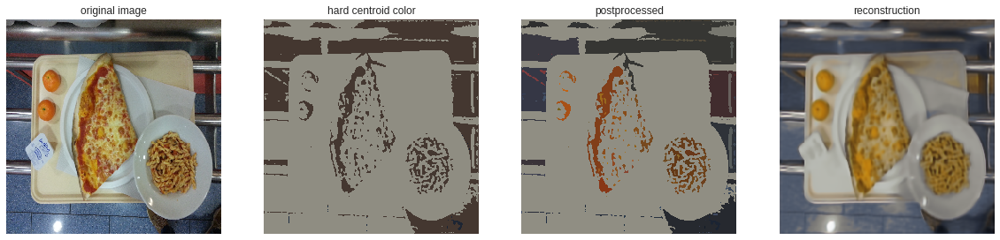

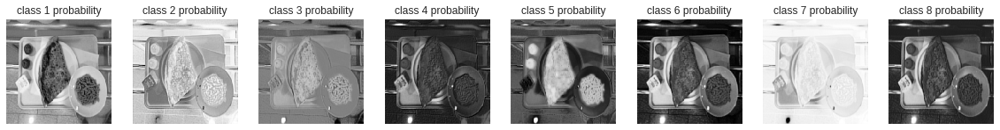

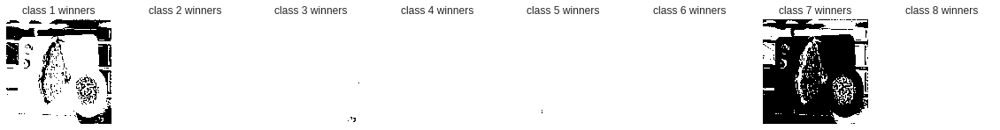

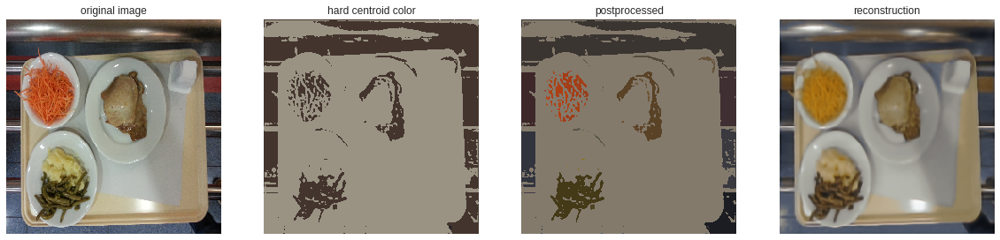

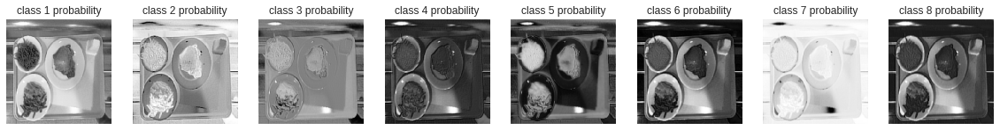

...

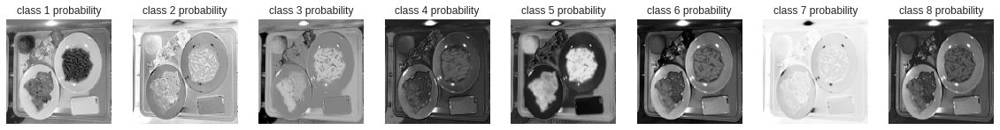

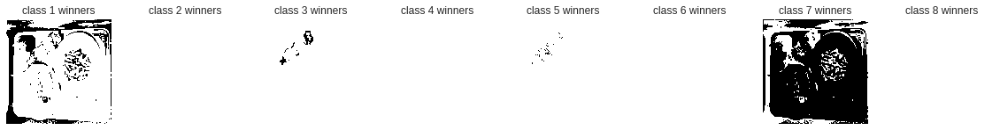

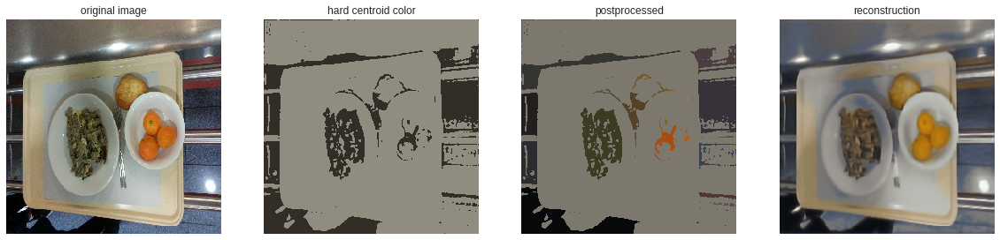

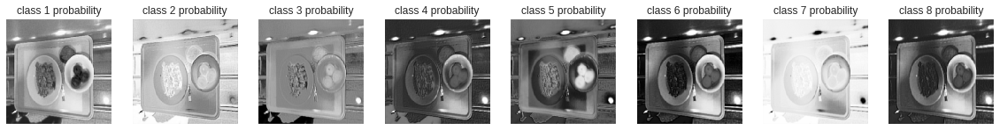

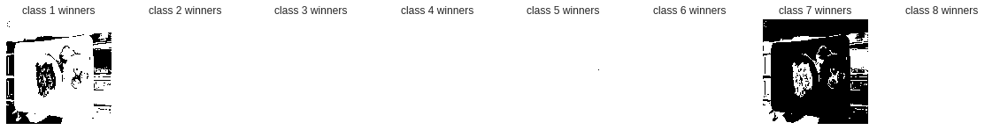

In [60]:
test_images = []
for i in [0,1,2,3,4,5,6,7]:  
  imgee = np.zeros((1,256,256,3))
  im = imread('data/original/' + test_ids[i] + '.jpg')[:,:,:3]
  im = resize(im, (256, 256), mode='constant')
  imgee[0] = im
  y_s = w_net.predict(imgee,batch_size=1)
  segm = y_s[0][0]
  rec = y_s[1][0]
  paints(imgee[0],segm,rec)
  test_images.append(segm)

#### IOU Computation

In [59]:
suma = 0
for i in [0,1,2,3,4,5,6,7]: 
  im = imread('data/original/' + test_ids[i] + '.jpg')[:,:,:3]
  im = resize(im, (256, 256), mode='constant') 
  len(test_images)
  suma = suma+segmentation_IOU(im, test_images[i], i)
print("IOU for W-net 18-32 without centroid loss: {}".format(suma/8))

IOU for W-net 18-32 without centroid loss: 0.2007621269622172


#### Contour Visualization

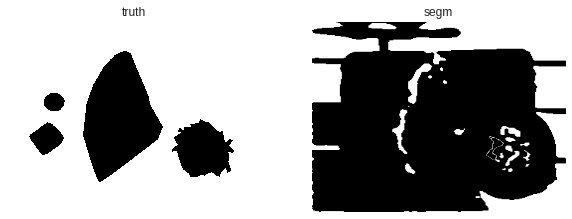

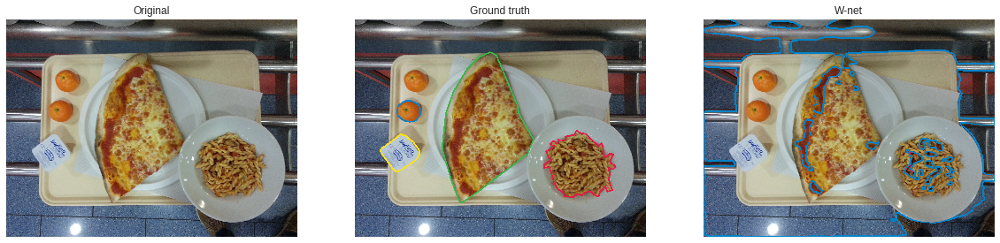

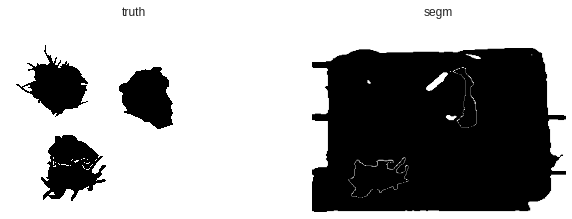

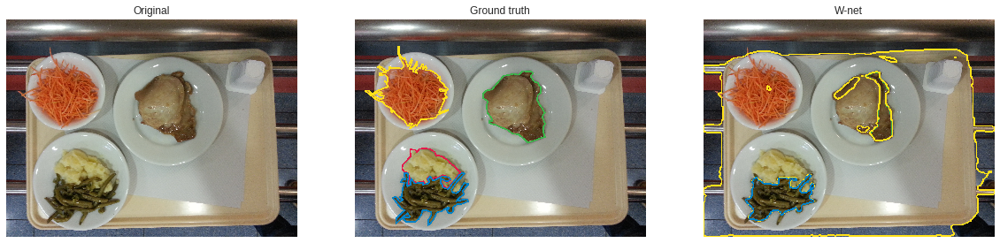

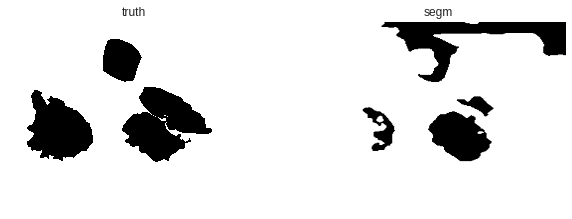

...

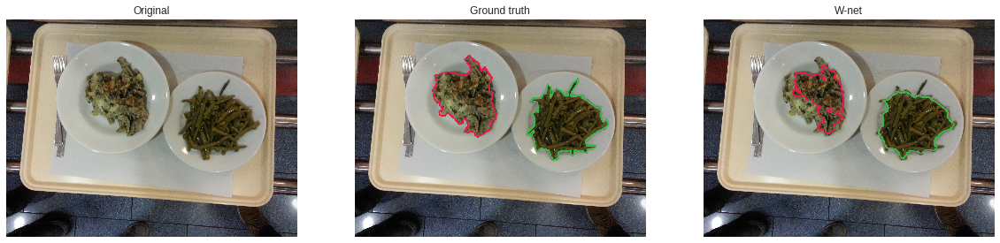

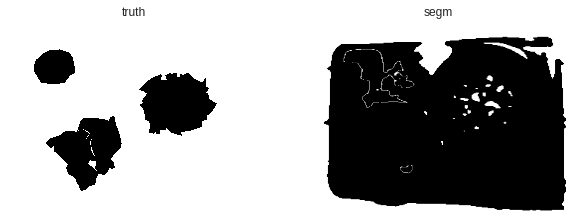

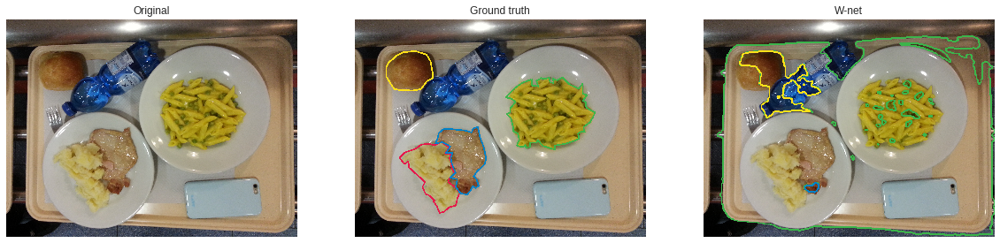

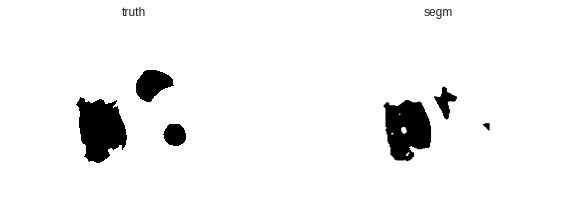

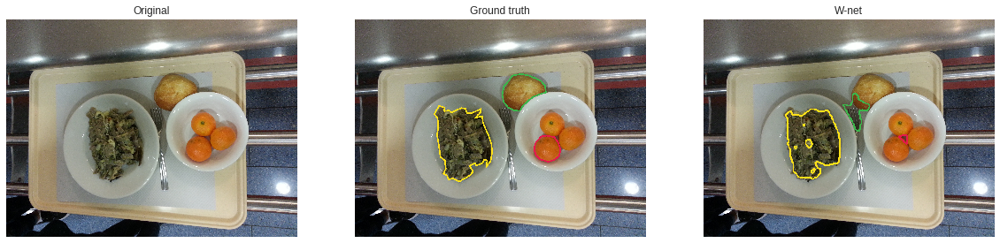

In [77]:
for i in [0,1,2,3,4,5,6,7]: 
  im = imread('data/original/' + test_ids[i] + '.jpg')[:,:,:3]
  im = resize(im, (256, 256), mode='constant') 
  P = get_connectivity_split(img, test_images[i])
  plot_comparison_contours(test_ids[i], P)